In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
import re
import shutil
import pandas as pd
import scipy.stats

import exdir
import expipe
from distutils.dir_util import copy_tree
import septum_mec
import spatial_maps as sp
import head_direction.head as head
import septum_mec.analysis.data_processing as dp
import septum_mec.analysis.registration
from septum_mec.analysis.plotting import violinplot, despine
from spatial_maps.fields import (
    find_peaks, calculate_field_centers, separate_fields_by_laplace, 
    map_pass_to_unit_circle, calculate_field_centers, distance_to_edge_function, 
    which_field, compute_crossings)
from phase_precession import cl_corr
from spike_statistics.core import permutation_resampling
import matplotlib.mlab as mlab
import scipy.signal as ss
from scipy.interpolate import interp1d
from septum_mec.analysis.plotting import regplot
from skimage import measure
from tqdm.notebook import tqdm_notebook as tqdm
tqdm.pandas()

12:33:01 [I] klustakwik KlustaKwik2 version 0.2.6
/home/mikkel/.virtualenvs/expipe/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/home/mikkel/.virtualenvs/expipe/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/home/mikkel/.virtualenvs/expipe/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


In [3]:
# %matplotlib notebook
%matplotlib inline

In [4]:
project_path = dp.project_path()
project = expipe.get_project(project_path)
actions = project.actions

output_path = pathlib.Path("output") / "phase-precession"
(output_path / "statistics").mkdir(exist_ok=True, parents=True)
(output_path / "figures").mkdir(exist_ok=True, parents=True)

# Load cell statistics and shuffling quantiles

In [5]:
statistics_action = actions['calculate-statistics']
identification_action = actions['identify-neurons']
sessions = pd.read_csv(identification_action.data_path('sessions'))
units = pd.read_csv(identification_action.data_path('units'))
session_units = pd.merge(sessions, units, on='action')
statistics_results = pd.read_csv(statistics_action.data_path('results'))
statistics = pd.merge(session_units, statistics_results, how='left')
statistics.head()

,action,baseline,entity,frequency,i,ii,session,stim_location,stimulated,tag,...,burst_event_ratio,bursty_spike_ratio,gridness,border_score,information_rate,information_specificity,head_mean_ang,head_mean_vec_len,spacing,orientation
0,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,0.398230,0.678064,-0.466923,0.029328,1.009215,0.317256,5.438033,0.040874,0.628784,20.224859
1,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,0.138014,0.263173,-0.666792,0.308146,0.192524,0.033447,1.951740,0.017289,0.789388,27.897271
2,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,0.373986,0.659259,-0.572566,0.143252,4.745836,0.393704,4.439721,0.124731,0.555402,28.810794
3,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,0.087413,0.179245,-0.437492,0.268948,0.157394,0.073553,6.215195,0.101911,0.492250,9.462322
4,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,0.248771,0.463596,-0.085938,0.218744,0.519153,0.032683,1.531481,0.053810,0.559905,0.000000


In [6]:
statistics['unit_day'] = statistics.apply(lambda x: str(x.unit_idnum) + '_' + x.action.split('-')[1], axis=1)

In [7]:
stim_response_action = actions['stimulus-response']
stim_response_results = pd.read_csv(stim_response_action.data_path('results'))

In [8]:
statistics = pd.merge(statistics, stim_response_results, how='left')

In [9]:
print('N cells:',statistics.shape[0])

N cells: 1284


In [10]:
shuffling = actions['shuffling']
quantiles_95 = pd.read_csv(shuffling.data_path('quantiles_95'))
quantiles_95.head()

,border_score,gridness,head_mean_ang,head_mean_vec_len,information_rate,speed_score,action,channel_group,unit_name
0,0.348023,0.275109,3.012689,0.086792,0.707197,0.149071,1833-010719-1,0.0,127.0
1,0.362380,0.166475,3.133138,0.037271,0.482486,0.132212,1833-010719-1,0.0,161.0
2,0.367498,0.266865,5.586395,0.182843,0.271188,0.062821,1833-010719-1,0.0,191.0
3,0.331942,0.312155,5.955767,0.090786,0.354018,0.052009,1833-010719-1,0.0,223.0
4,0.325842,0.180495,5.262721,0.103584,0.210427,0.094041,1833-010719-1,0.0,225.0


In [11]:
action_columns = ['action', 'channel_group', 'unit_name']
data = pd.merge(statistics, quantiles_95, on=action_columns, suffixes=("", "_threshold"))

data['specificity'] = np.log10(data['in_field_mean_rate'] / data['out_field_mean_rate'])

data.head()

,action,baseline,entity,frequency,i,ii,session,stim_location,stimulated,tag,...,p_e_peak,t_i_peak,p_i_peak,border_score_threshold,gridness_threshold,head_mean_ang_threshold,head_mean_vec_len_threshold,information_rate_threshold,speed_score_threshold,specificity
0,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.332548,0.229073,6.029431,0.205362,1.115825,0.066736,0.451741
1,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.354830,0.089333,6.120055,0.073566,0.223237,0.052594,0.098517
2,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.264610,-0.121081,5.759406,0.150827,4.964984,0.027120,0.400770
3,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.344280,0.215829,6.033364,0.110495,0.239996,0.054074,0.269461
4,1849-060319-3,True,1849,NaN,False,True,3,NaN,False,baseline ii,...,NaN,NaN,NaN,0.342799,0.218967,5.768170,0.054762,0.524990,0.144702,0.133410


# Statistics about all cell-sessions

In [12]:
data.groupby('stimulated').count()['action']

stimulated
False    624
True     660
Name: action, dtype: int64

# Find all cells with gridness above threshold

In [13]:
query = (
    'gridness > gridness_threshold and '
    'information_rate > information_rate_threshold and '
    'gridness > .2 and '
    'average_rate < 25'
)
sessions_above_threshold = data.query(query)
print("Number of sessions above threshold", len(sessions_above_threshold))
print("Number of animals", len(sessions_above_threshold.groupby(['entity'])))

Number of sessions above threshold 194
Number of animals 4


## select neurons that have been characterized as a grid cell on the same day

In [14]:
once_a_gridcell = statistics[statistics.unit_day.isin(sessions_above_threshold.unit_day.values)]

In [15]:
print("Number of gridcells", once_a_gridcell.unit_idnum.nunique())
print("Number of gridcell recordings", len(once_a_gridcell))
print("Number of animals", len(once_a_gridcell.groupby(['entity'])))

Number of gridcells 139
Number of gridcell recordings 231
Number of animals 4


# divide into stim not stim

In [16]:
baseline_i = once_a_gridcell.query('baseline and Hz11')
stimulated_11 = once_a_gridcell.query('stimulated and frequency==11 and stim_location=="ms"')

baseline_ii = once_a_gridcell.query('baseline and Hz30')
stimulated_30 = once_a_gridcell.query('stimulated and frequency==30 and stim_location=="ms"')

print("Number of gridcells in baseline i sessions", len(baseline_i))
print("Number of gridcells in stimulated 11Hz ms sessions", len(stimulated_11))

print("Number of gridcells in baseline ii sessions", len(baseline_ii))
print("Number of gridcells in stimulated 30Hz ms sessions", len(stimulated_30))

Number of gridcells in baseline i sessions 66
Number of gridcells in stimulated 11Hz ms sessions 61
Number of gridcells in baseline ii sessions 56
Number of gridcells in stimulated 30Hz ms sessions 40


In [17]:
baseline_ids = baseline_i.unit_idnum.unique()

In [18]:
baseline_ids

array([ 30,  31,  32,  78,  79, 150, 205, 243, 263, 265,  45,  46,  47,
        49,  96, 118, 121, 185, 186, 106, 168, 231, 232, 233, 379, 609,
       658, 615, 616, 666, 667, 179, 214, 278, 279, 317, 613, 661, 361,
       362, 851, 357, 358, 359, 332, 338, 655, 715,   8,  56,  57,  58,
       129, 130, 132,  23, 174, 250, 251, 252, 253, 304, 932])

In [19]:
stimulated_11_sub = stimulated_11[stimulated_11.unit_idnum.isin(baseline_ids)]

In [20]:
baseline_ids_11 = stimulated_11_sub.unit_idnum.unique()

In [21]:
baseline_i_sub = baseline_i[baseline_i.unit_idnum.isin(baseline_ids_11)]

# Plotting

In [22]:
max_speed = .5 # m/s only used for speed score
min_speed = 0.02 # m/s only used for speed score
position_sampling_rate = 100 # for interpolation
position_low_pass_frequency = 6 # for low pass filtering of position

box_size = [1.0, 1.0]
bin_size = 0.02
smoothing_low = 0.03
smoothing_high = 0.06

speed_binsize = 0.02

stim_mask = True
baseline_duration = 600

In [23]:
data_loader = dp.Data(
    position_sampling_rate=position_sampling_rate, 
    position_low_pass_frequency=position_low_pass_frequency,
    box_size=box_size, bin_size=bin_size, 
    stim_mask=stim_mask, baseline_duration=baseline_duration
)

In [24]:
from scipy.signal import butter, filtfilt

def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = filtfilt(b, a, data)
    return y

In [25]:
def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m / sd)


def remove_artifacts(anas, spikes=None, width=500, threshold=2, sampling_rate=None, fillval=0):
    sampling_rate = sampling_rate or anas.sampling_rate.magnitude
    times = np.arange(anas.shape[0]) / sampling_rate
    anas = np.array(anas)
    if anas.ndim == 1:
        anas = np.reshape(anas, (anas.size, 1))
    assert len(times) == anas.shape[0]
    nchan = anas.shape[1]
    if spikes is not None:
        spikes = np.array(spikes)
    for ch in range(nchan):
        idxs, = np.where(abs(anas[:, ch]) > threshold)
        for idx in idxs:
            if spikes is not None:
                t0 = times[idx-width]
                stop = idx+width
                if stop > len(times) - 1:
                    stop = len(times) - 1 
                t1 = times[stop]
                mask = (spikes > t0) & (spikes < t1)
                spikes = spikes[~mask]
            anas[idx-width:idx+width, ch] = fillval
    if spikes is not None:
        spikes = spikes[spikes <= times[-1]]
        return anas, times, spikes
    else:
        return anas, times

In [26]:
def find_theta_peak(p, f, f1, f2):
    if np.all(np.isnan(p)):
        return np.nan, np.nan
    mask = (f > f1) & (f < f2)
    p_m = p[mask]
    f_m = f[mask]
    peaks = find_peaks(p_m)
    idx = np.argmax(p_m[peaks])
    return f_m[peaks[idx]], p_m[peaks[idx]]

In [27]:
def compute_spike_phase(lfp, times, return_degrees=False):
    x_a = ss.hilbert(lfp)
    x_phase = np.angle(x_a)
    if return_degrees:
        x_phase = x_phase * 180 / np.pi
    return interp1d(times, x_phase)

In [28]:
def find_grid_fields(rate_map, sigma=3, seed=2.5):
    # find fields with laplace
    fields_laplace = sp.fields.separate_fields_by_dilation(rate_map, sigma=sigma, seed=seed)
    fields = fields_laplace.copy() # to be cleaned by Ismakov
    fields_areas = scipy.ndimage.measurements.sum(
        np.ones_like(fields), fields, index=np.arange(fields.max() + 1))
    fields_area = fields_areas[fields]
    fields[fields_area < 9.0] = 0

    # find fields with Ismakov-method
    fields_ismakov, radius = sp.separate_fields_by_distance(rate_map)
    fields_ismakov_real = fields_ismakov * bin_size
    approved_fields = []

    # remove fields not found by both methods
    for point in fields_ismakov:
        field_id = fields[tuple(point)]
        approved_fields.append(field_id)

    for field_id in np.arange(1, fields.max() + 1):
        if not field_id in approved_fields:
            fields[fields == field_id] = 0
            
    return fields

In [29]:
def normalize(a):
    _a = a - a.min()
    return _a / _a.max()

In [30]:
def distance(x, y):
    _x = x - x.min()
    _y = y - y.min()
    dx, dy = np.diff(x), np.diff(y)
    s = np.sqrt(dx**2 + dy**2)
    distance = np.cumsum(s) 
    # first index is distance from first point, 
    # to match len(x) we put a zero as first index to initialize distance 0
    return np.concatenate(([0], distance))

In [31]:
def model(x, slope, phi0):
    return 2 * np.pi * slope * x + phi0

In [32]:
def compute_data(row, flim=[6,10]):
    lfp = data_loader.lfp(row.action, row.channel_group)
    spikes = data_loader.spike_train(row.action, row.channel_group, row.unit_name)
    rate_map = data_loader.rate_map(row.action, row.channel_group, row.unit_name, smoothing=0.04)
    pos_x, pos_y, pos_t, pos_speed = map(data_loader.tracking(row.action).get, ['x', 'y', 't', 'v'])
    
    spikes = np.array(spikes)
    spikes = spikes[(spikes > pos_t.min()) & (spikes < pos_t.max())]

    cleaned_lfp_, times_ = remove_artifacts(lfp)
    peak_amp = {}
    for i, ch in enumerate(cleaned_lfp_.T):
        pxx, freqs = mlab.psd(ch, Fs=lfp.sampling_rate.magnitude, NFFT=4000)
        f, p = find_theta_peak(pxx, freqs, *flim)
        peak_amp[i] = p

    theta_channel = max(peak_amp, key=lambda x: peak_amp[x])
    filtered_lfp = butter_bandpass_filter(
        lfp.magnitude[:,theta_channel], *flim, fs=lfp.sampling_rate.magnitude, order=3)
    
    cleaned_lfp, times, cleaned_spikes = remove_artifacts(
        filtered_lfp, spikes, threshold=2, sampling_rate=lfp.sampling_rate.magnitude, fillval=0)
    
    cleaned_lfp = cleaned_lfp.ravel()

    spike_phase_func = compute_spike_phase(cleaned_lfp, times)
    
    fields = find_grid_fields(rate_map, sigma=3, seed=2.5)
    
    return spike_phase_func, cleaned_spikes, pos_x, pos_y, pos_t, rate_map, fields

In [41]:
def compute_phase_precession(row, flim=[6, 10], return_runs=False, field_num=None, 
                             plot=False, plot_grid=False, plot_lines=True, save=False):
    spike_phase_func, cleaned_spikes, pos_x, pos_y, pos_t, rate_map, fields = compute_data(row, flim)
    
    if field_num is not None:
        fields = np.where(fields == field_num, fields, 0)
        
    in_field_indices = which_field(pos_x, pos_y, fields, box_size)
    in_field_enter, in_field_exit = compute_crossings(in_field_indices)

    if plot:
        if plot_grid:
            fig, axs = plt.subplots(2, 2)
            plt.suptitle(f'{row.action} {row.channel_group} {row.unit_idnum}')
        else:
            fig, ax = plt.subplots(1, 1)
            axs = [[ax]]
            ax.set_title(f'{row.action} {row.channel_group} {row.unit_idnum}')
        dot_size = 1

    in_field_spikes, in_field_dur, in_field_dist, spike_phase = [], [], [], []

    sx, sy = interp1d(pos_t, pos_x), interp1d(pos_t, pos_y)
    results = []
    for en, ex in zip(in_field_enter, in_field_exit):
        x, y, t = pos_x[en:ex+1], pos_y[en:ex+1], pos_t[en:ex+1]

        s = cleaned_spikes[(cleaned_spikes > t[0]) & (cleaned_spikes < t[-1])]
        if len(s) < 5:
            continue

        in_field_spikes.append(s)
        
        dist = distance(x, y)
        t_to_dist_norm = interp1d(t, normalize(dist))
        t_to_dist = interp1d(t, dist)
        in_field_dist.append(t_to_dist_norm(s))
        
        t_to_dur = interp1d(t, t)
        t_to_dur_norm = interp1d(t, normalize(t))
        in_field_dur.append(t_to_dur_norm(s))
        
        spike_phase.append(spike_phase_func(s))
        if return_runs:
            circ_lin_corr_dist, pval_dist, slope_dist, phi0_dist, RR_dist = cl_corr(
                t_to_dist(s), spike_phase_func(s), -100, 100, return_pval=True)
            circ_lin_corr_dur, pval_dur, slope_dur, phi0_dur, RR_dur = cl_corr(
                s - t[0], spike_phase_func(s), -100, 100, return_pval=True)
            result_run = {
                'action': row.action, 
                'channel_group': row.channel_group, 
                'unit_name': row.unit_name,
                'circ_lin_corr_dist': circ_lin_corr_dist, 
                'pval_dist': pval_dist, 
                'slope_dist': slope_dist, 
                'phi0_dist': phi0_dist, 
                'RR_dist': RR_dist,
                'circ_lin_corr_dur': circ_lin_corr_dur, 
                'pval_dur': pval_dur, 
                'slope_dur': slope_dur, 
                'phi0_dur': phi0_dur, 
                'RR_dur': RR_dur
            }
            results.append(result_run)
            if plot:
                p = axs[0][0].scatter(t_to_dist(s), spike_phase_func(s), s=dot_size)
                axs[0][0].scatter(
                    t_to_dist(s), spike_phase_func(s) + 2 * np.pi, 
                    s=dot_size, color=p.get_facecolor()[0])
                axs[0][0].set_yticks([-np.pi, np.pi, 3*np.pi])
                axs[0][0].set_yticklabels([r'$-\pi$', r'$\pi$', r'$3\pi$'])
                if plot_lines:
                    line_fit = model(np.array([0, .4]), slope_dist, phi0_dist)
                    axs[0][0].plot([0, .4], line_fit, lw=2, label=
                        f'corr = {circ_lin_corr_dist:.3f}, '
                        f'pvalue = {pval_dist:.3f}, '
                        f'R = {RR_dist:.3f}')
        
        if plot and plot_grid:
            axs[0][1].plot(x, y)
            axs[0][1].scatter(sx(s), sy(s), s=dot_size, color='r', zorder=100000)
        
    dist = np.array([d for di in in_field_dist for d in di])
    dur = np.array([d for di in in_field_dur for d in di])
    phase = np.array([d for di in spike_phase for d in di])
    if not return_runs:
        circ_lin_corr_dist, pval_dist, slope_dist, phi0_dist, RR_dist = cl_corr(
            dist, phase, -2, 2, return_pval=True)
        circ_lin_corr_dur, pval_dur, slope_dur, phi0_dur, RR_dur = cl_corr(
            dur, phase, -2, 2, return_pval=True)

        results = {
            'action': row.action, 
            'channel_group': row.channel_group, 
            'unit_name': row.unit_name,
            'circ_lin_corr_dist': circ_lin_corr_dist, 
            'pval_dist': pval_dist, 
            'slope_dist': slope_dist, 
            'phi0_dist': phi0_dist, 
            'RR_dist': RR_dist,
            'circ_lin_corr_dur': circ_lin_corr_dur, 
            'pval_dur': pval_dur, 
            'slope_dur': slope_dur, 
            'phi0_dur': phi0_dur, 
            'RR_dur': RR_dur
        }
        if plot:
            axs[0][0].scatter(dist, phase, s=dot_size, color='k')
            axs[0][0].scatter(dist, phase + 2 * np.pi, s=dot_size, color='k')
            axs[0][0].set_yticks([-np.pi, np.pi, 3*np.pi])
            axs[0][0].set_yticklabels([r'$-\pi$', r'$\pi$', r'$3\pi$'])
            if plot_lines:
                line_fit = model(np.array([0, 1]), slope_dist, phi0_dist)
                axs[0][0].plot([0, 1], line_fit, lw=2, color='grey')
#                 axs[0][0].set_title(
#                         f'corr = {circ_lin_corr_dist:.3f}, '
#                         f'pvalue = {pval_dist:.3f}, '
#                         f'R = {RR_dist:.3f}')
    if plot and plot_grid:
        contours = measure.find_contours(fields, 0.8)

        # Display the image and plot all contours found
        axs[1][0].imshow(rate_map.T, extent=[0, box_size[0], 0, box_size[1]], origin='lower')
        axs[1][1].plot(pos_x, pos_y, color='k', alpha=.2, zorder=1000)
        axs[1][1].scatter(
            interp1d(pos_t, pos_x)(cleaned_spikes), interp1d(pos_t, pos_y)(cleaned_spikes), 
            s=1, zorder=10001)

        for ax in axs.ravel()[1:]:
            for n, contour in enumerate(contours):
                ax.plot(contour[:, 0] * bin_size, contour[:, 1] * bin_size, linewidth=2)
            
        for ax in axs.ravel()[1:]:
            ax.axis('image')
            ax.set_xticks([])
            ax.set_yticks([])
        
        axs[0][0].set_aspect(1 / (4*np.pi))
    if plot:
        despine()
        if plot_lines:
            plt.legend()
    if plot and save:
        figname = f'{row.action}_{row.channel_group}_{row.unit_idnum}_f{flim[0]}-{flim[1]}'
        fig.savefig(
            output_path / 'figures' / f'{figname}.png', 
            bbox_inches='tight', transparent=True)
        fig.savefig(
            output_path / 'figures' / f'{figname}.svg', 
            bbox_inches='tight', transparent=True)
    
    return results

In [42]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (2, 2), 
    'figure.dpi': 150
})

{'action': '1833-260619-2',
 'channel_group': 0,
 'unit_name': 174,
 'circ_lin_corr_dist': 0.015035045939466871,
 'pval_dist': 0.58032151303154,
 'slope_dist': 0.31943787776044974,
 'phi0_dist': 4.843627836303633,
 'RR_dist': 0.03720602786152166,
 'circ_lin_corr_dur': 0.008726766011604742,
 'pval_dur': 0.7501129594935525,
 'slope_dur': 0.12178247278219806,
 'phi0_dur': 5.408259850880937,
 'RR_dur': 0.034326500937119704}

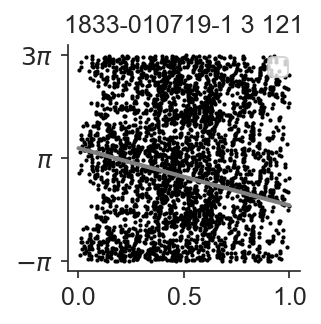

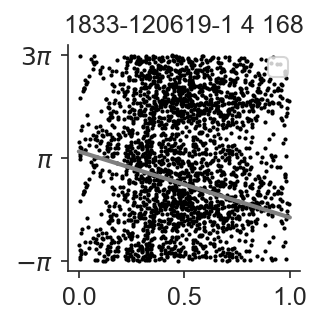

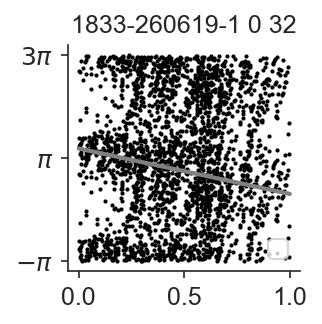

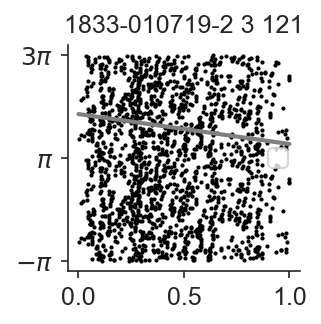

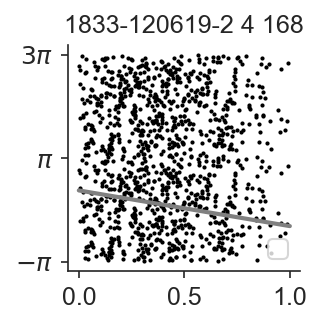

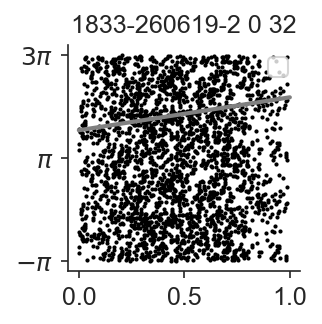

In [43]:
compute_phase_precession(
     data.query('action=="1833-010719-1" and unit_idnum==121').iloc[0], 
     plot=True, save=True, plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-120619-1" and unit_idnum==168').iloc[0], 
     plot=True, save=True, plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-260619-1" and unit_idnum==32').iloc[0], 
     plot=True, save=True, plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-010719-2" and unit_idnum==121').iloc[0], 
     plot=True, save=True, plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-120619-2" and unit_idnum==168').iloc[0], 
     plot=True, save=True, plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-260619-2" and unit_idnum==32').iloc[0], 
     plot=True, save=True, plot_lines=True)

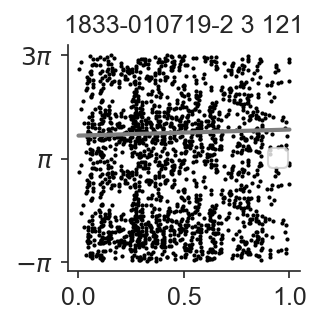

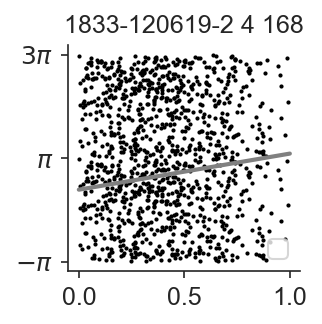

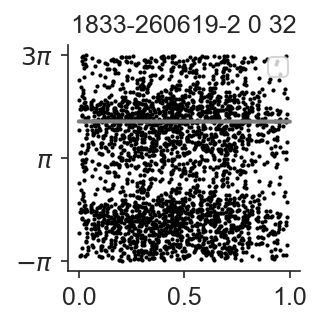

In [44]:
compute_phase_precession(
     data.query('action=="1833-010719-2" and unit_idnum==121').iloc[0], 
     plot=True, save=True, flim=[10,12], plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-120619-2" and unit_idnum==168').iloc[0], 
     plot=True, save=True, flim=[10,12], plot_lines=True)
compute_phase_precession(
     data.query('action=="1833-260619-2" and unit_idnum==32').iloc[0], 
     plot=True, save=True, flim=[10,12], plot_lines=True);

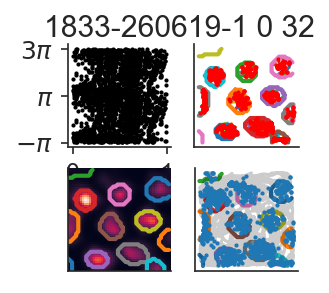

In [373]:
 compute_phase_precession(baseline_i.sort_values('gridness', ascending=False).iloc[18], plot=True, plot_grid=True);

[{'action': '1833-260619-1',
  'channel_group': 0,
  'unit_name': 132,
  'circ_lin_corr_dist': 0.4129467750189508,
  'pval_dist': 0.28464111660579006,
  'slope_dist': 28.093945031625527,
  'phi0_dist': 0.16742503048943053,
  'RR_dist': 0.8263134195104782,
  'circ_lin_corr_dur': 0.45019436077125674,
  'pval_dur': 0.23466570092972083,
  'slope_dur': 7.60530119306991,
  'phi0_dur': 2.559041546574352,
  'RR_dur': 0.9151777474060984},
 {'action': '1833-260619-1',
  'channel_group': 0,
  'unit_name': 132,
  'circ_lin_corr_dist': 0.9172178573980904,
  'pval_dist': 0.04558526041179123,
  'slope_dist': 20.643552625318872,
  'phi0_dist': 3.7770417048542133,
  'RR_dist': 0.9494493337637299,
  'circ_lin_corr_dur': -0.7812146888876957,
  'pval_dur': 0.060057201741145594,
  'slope_dur': -68.05547576848763,
  'phi0_dur': 1.8139821995133372,
  'RR_dur': 0.6676959218271774},
 {'action': '1833-260619-1',
  'channel_group': 0,
  'unit_name': 132,
  'circ_lin_corr_dist': -0.265840449081054,
  'pval_dist':

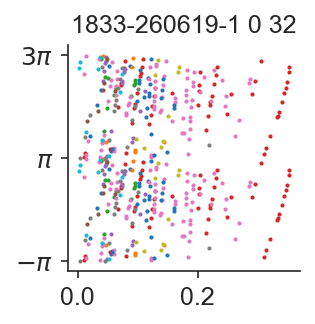

In [388]:
 compute_phase_precession(
     baseline_i.sort_values('gridness', ascending=False).iloc[18], 
     plot=True, field_num=1, return_runs=True, plot_lines=False)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


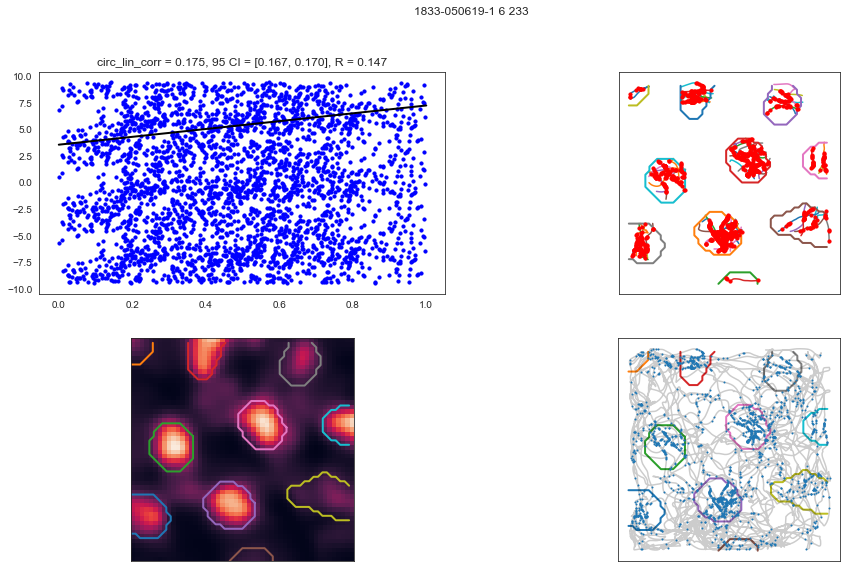

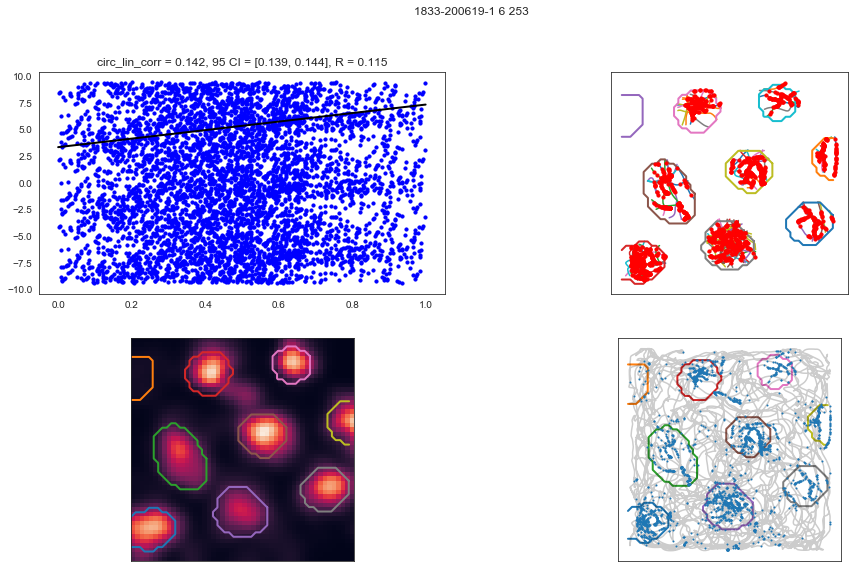

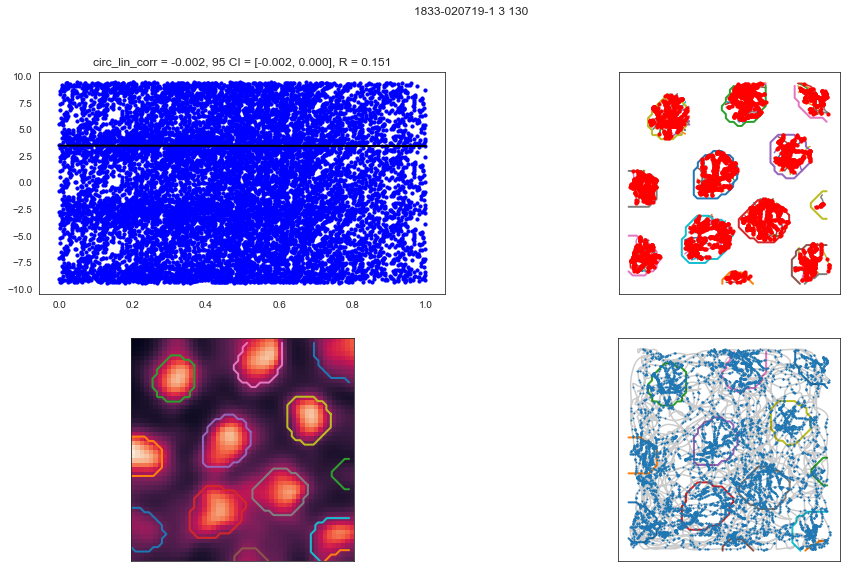

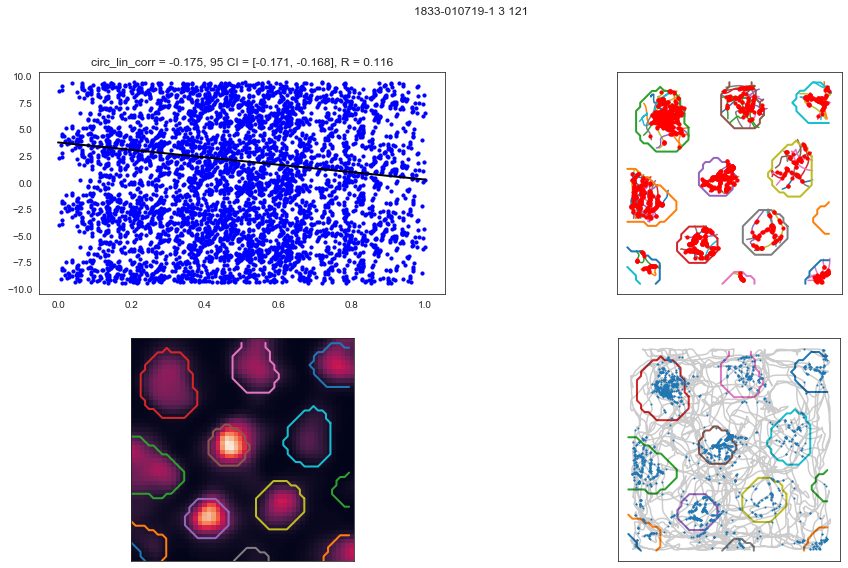

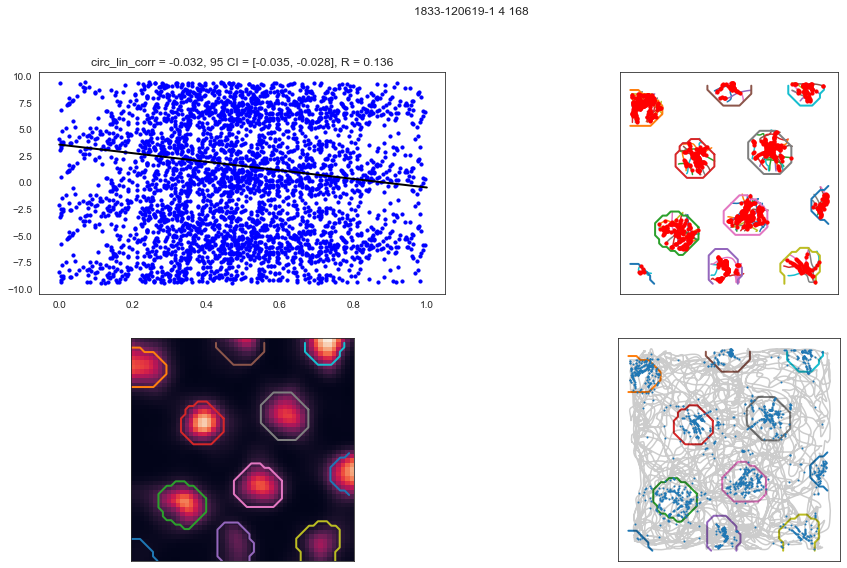

...

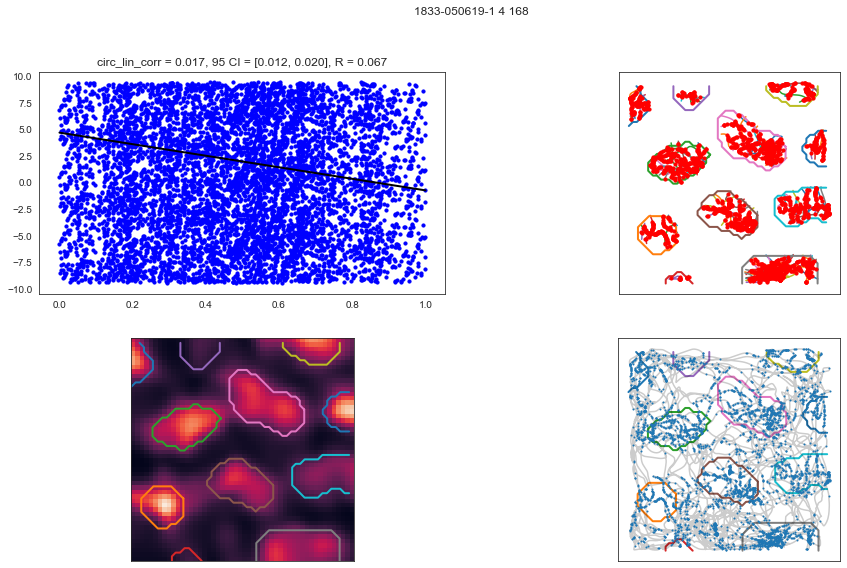

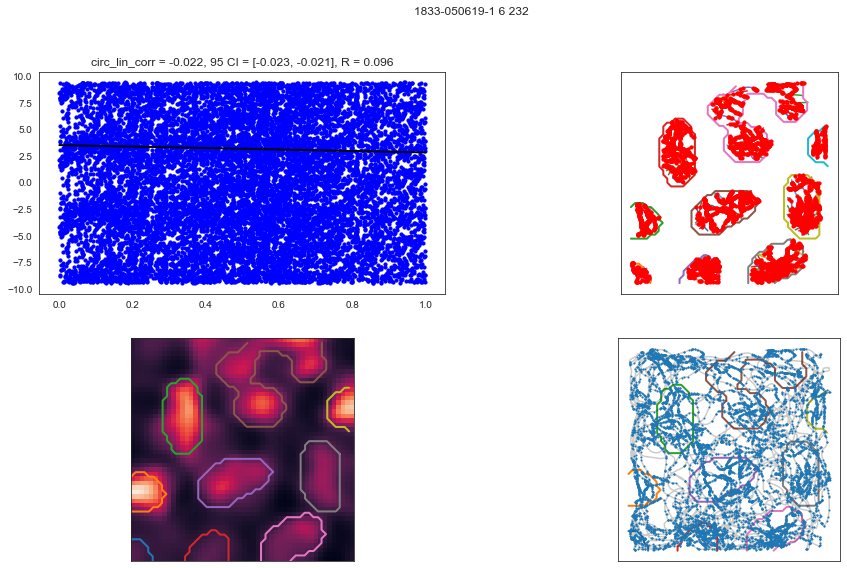

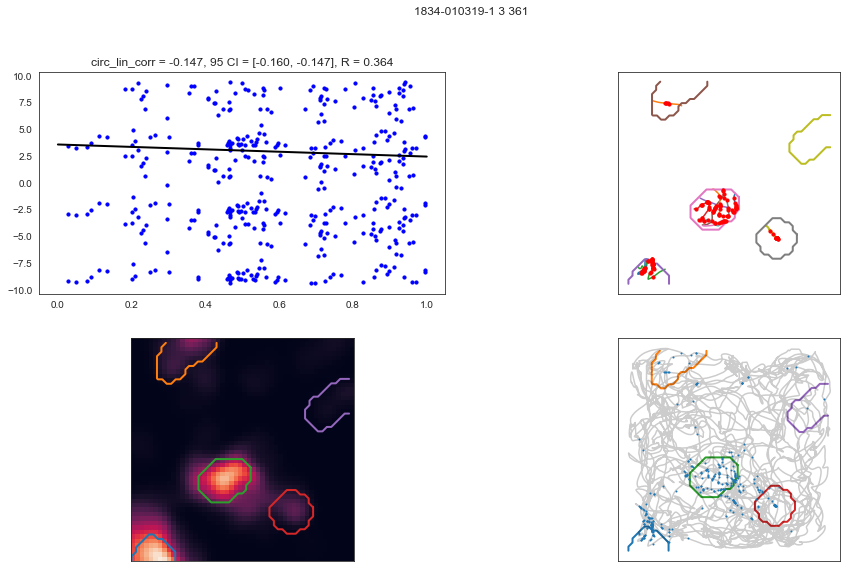

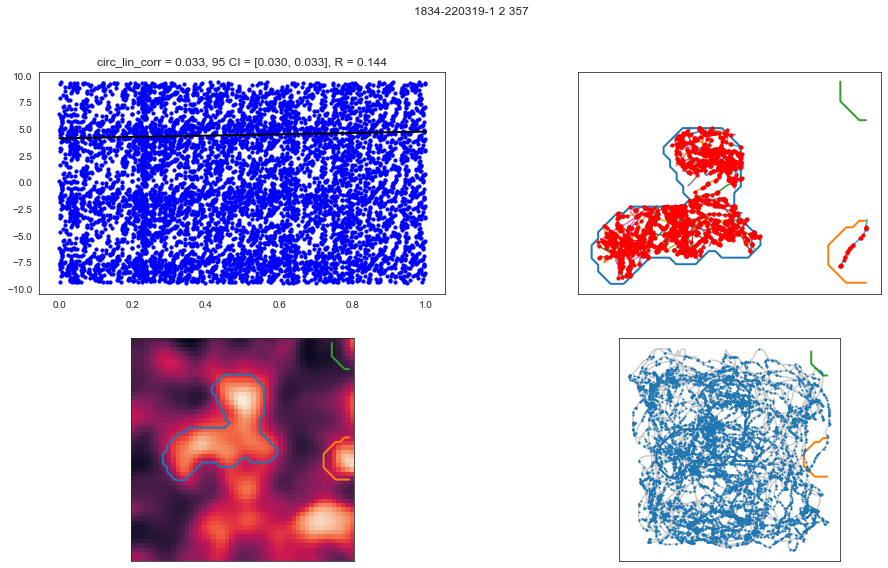

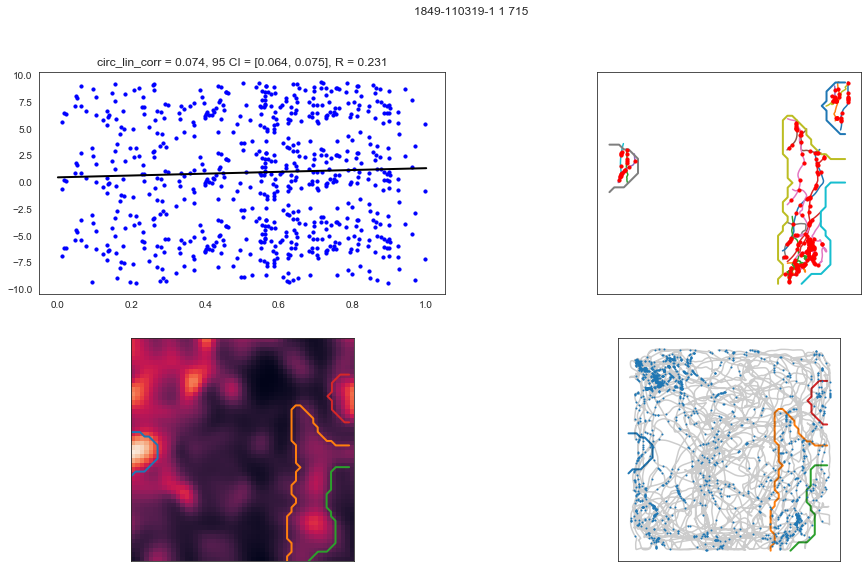

In [195]:
for row in baseline_i.sort_values('gridness', ascending=False).itertuples():
    compute_phase_precession(row, plot=True)

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


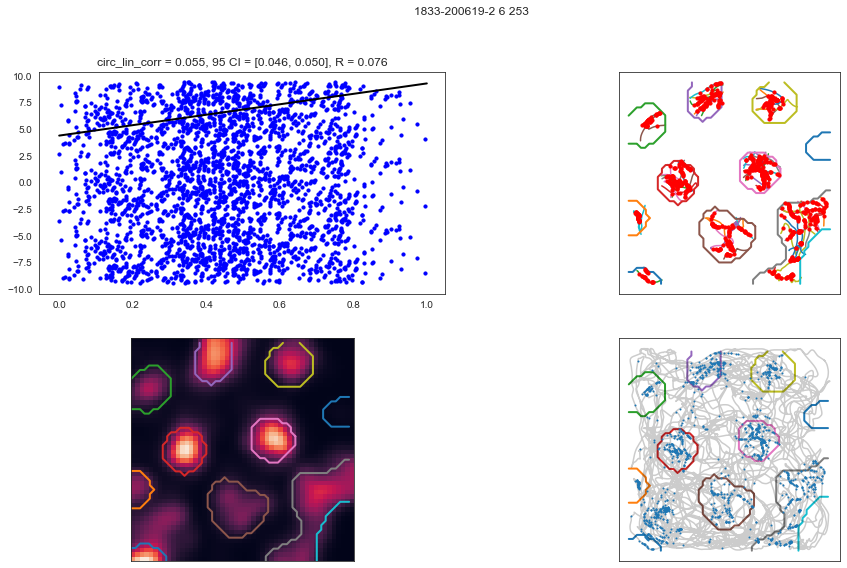

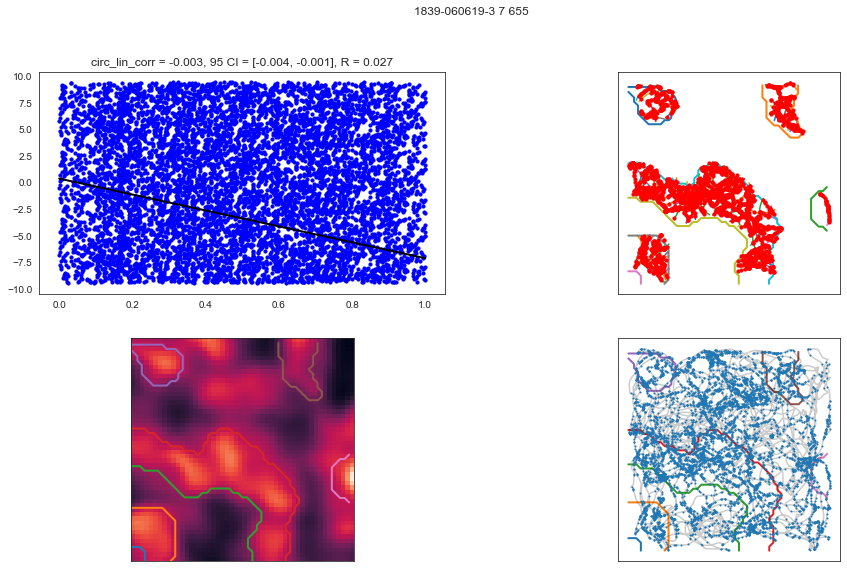

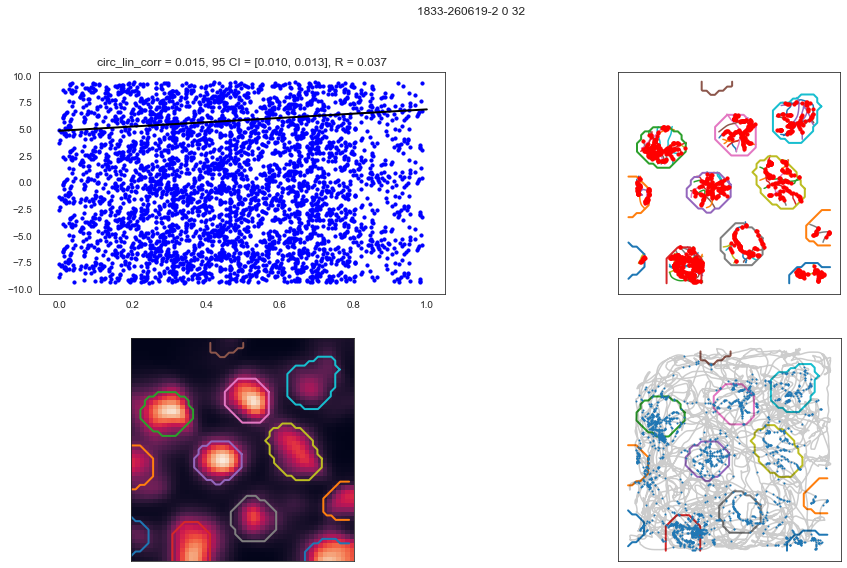

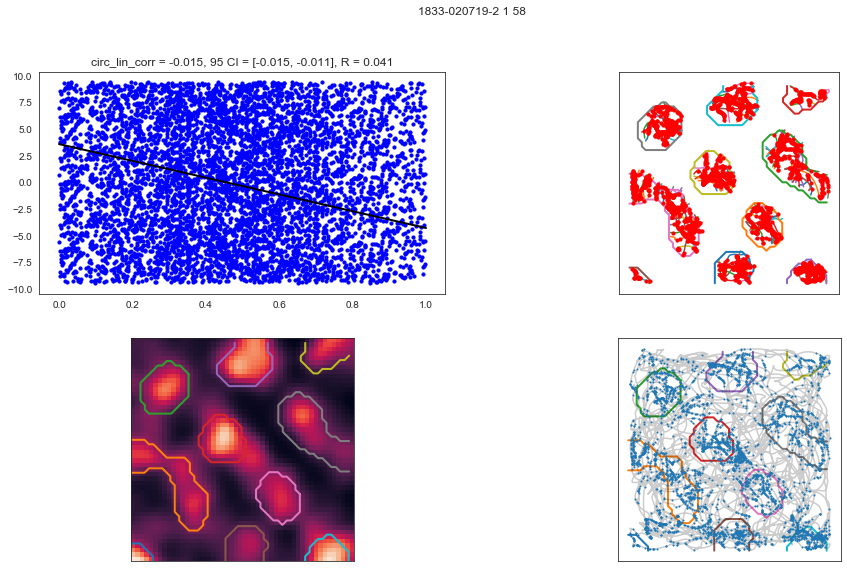

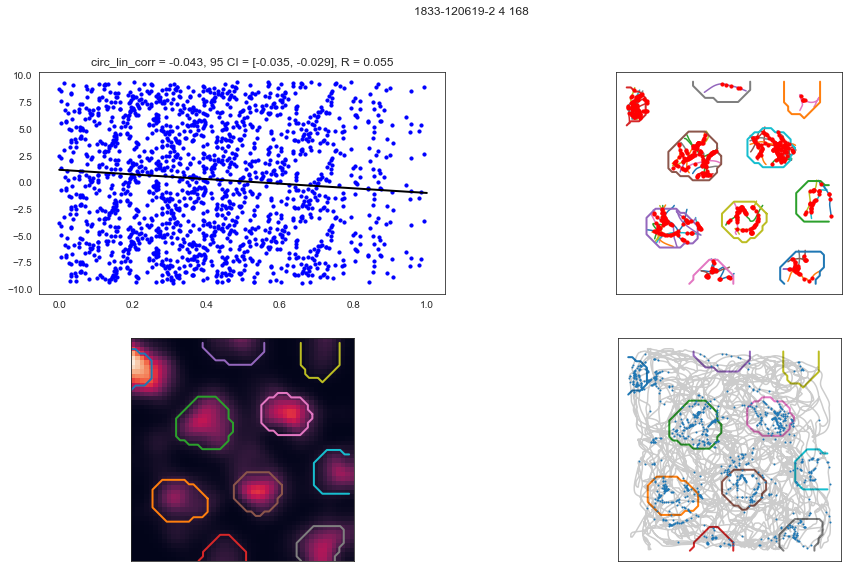

...

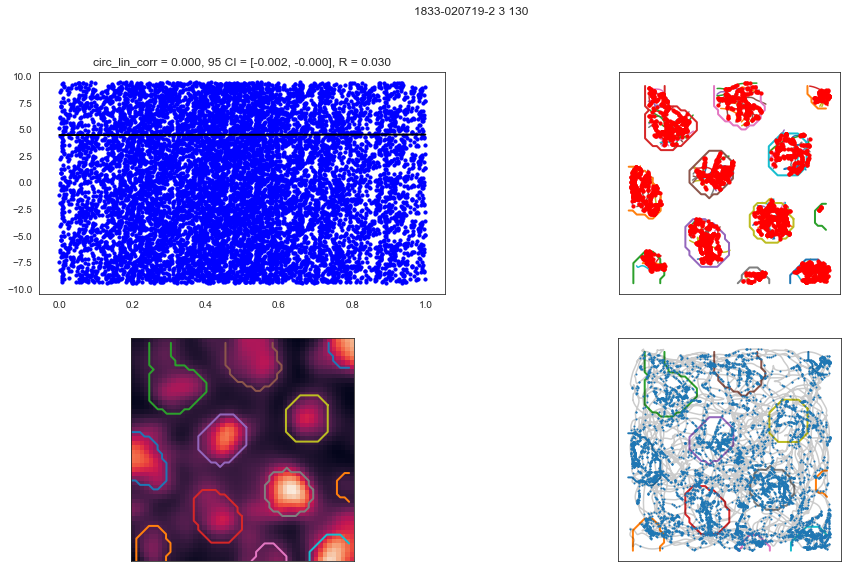

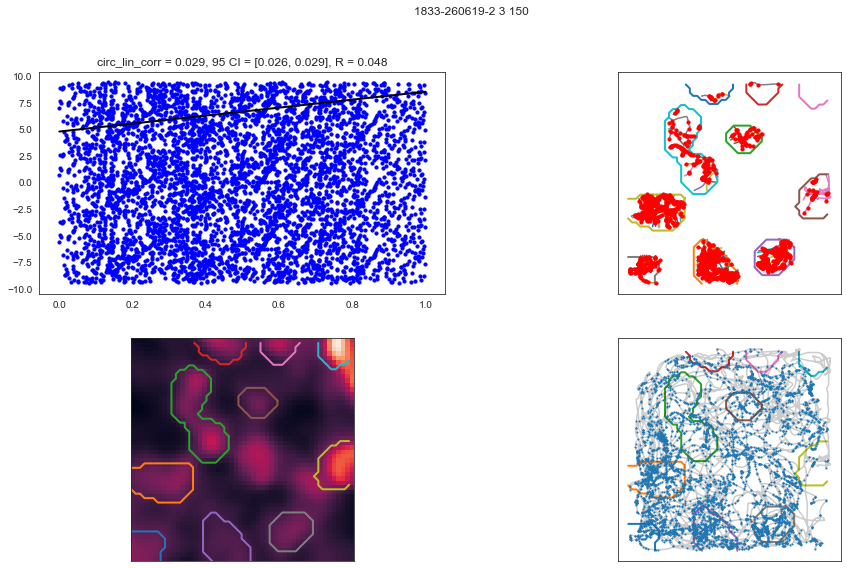

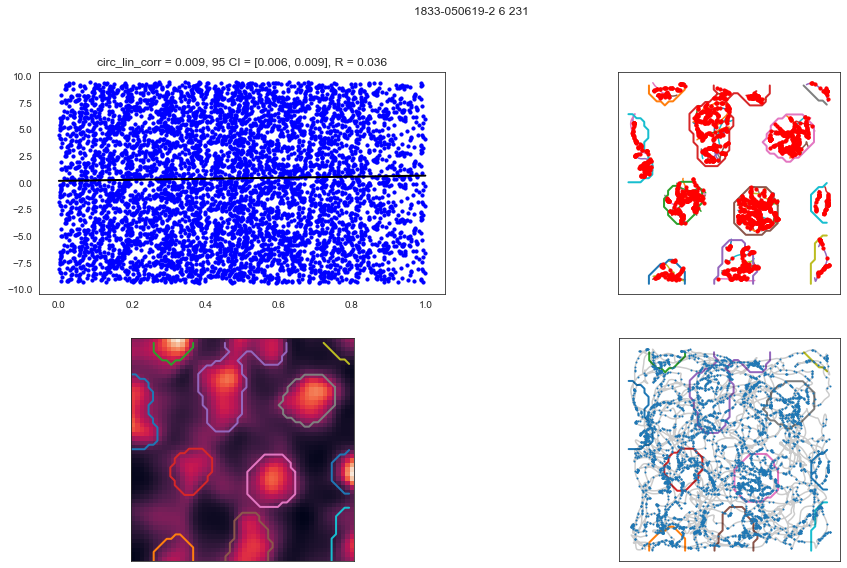

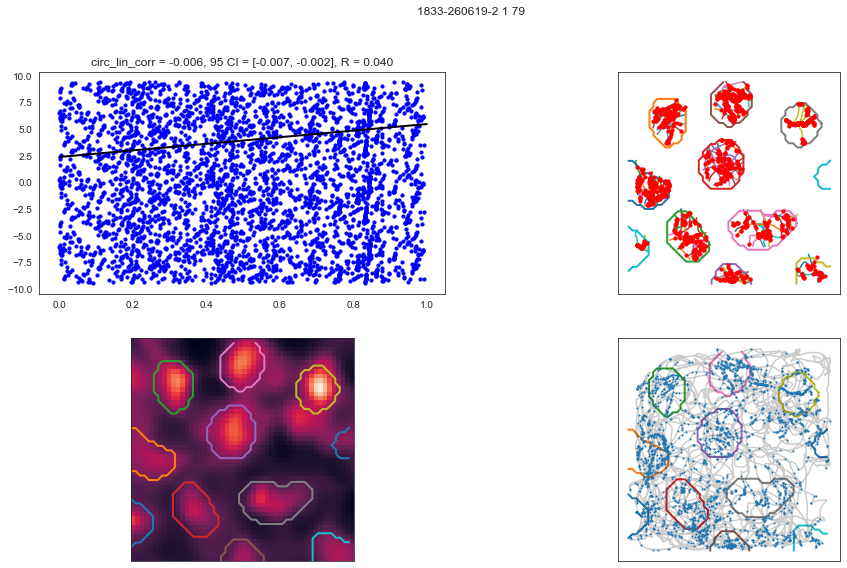

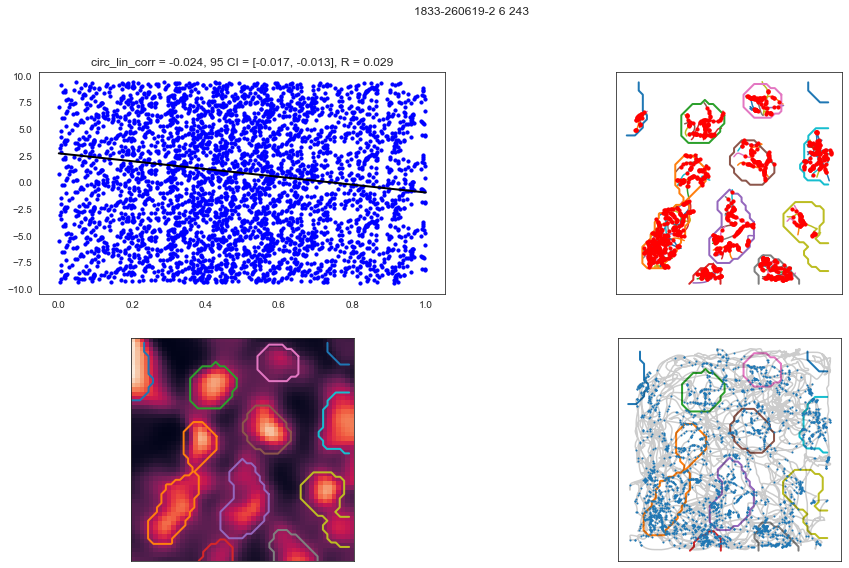

In [196]:
for row in stimulated_11_sub.sort_values('gridness', ascending=False).itertuples():
    compute_phase_precession(row, plot=True, flim=[6,10])

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


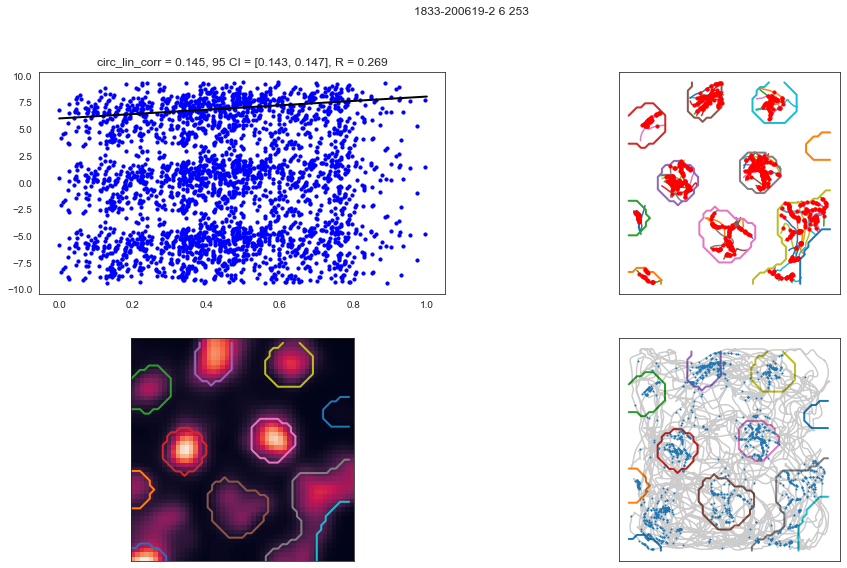

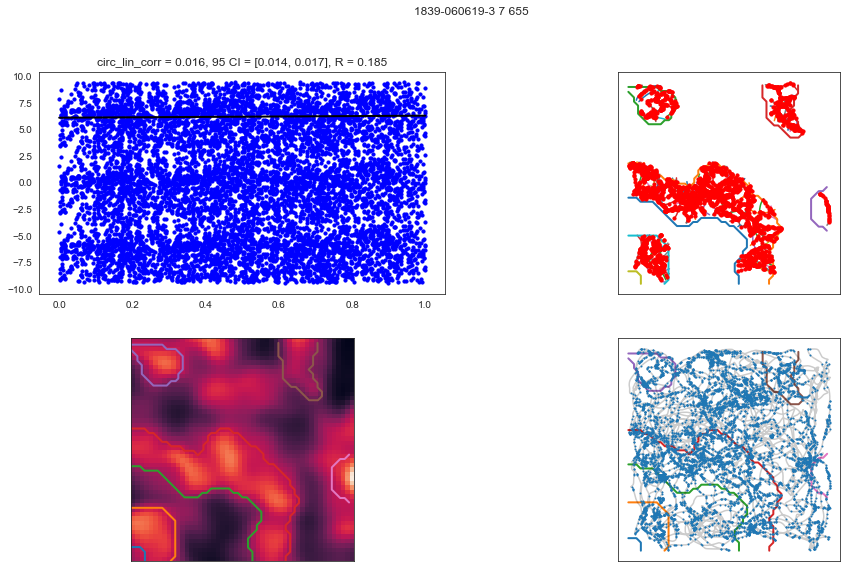

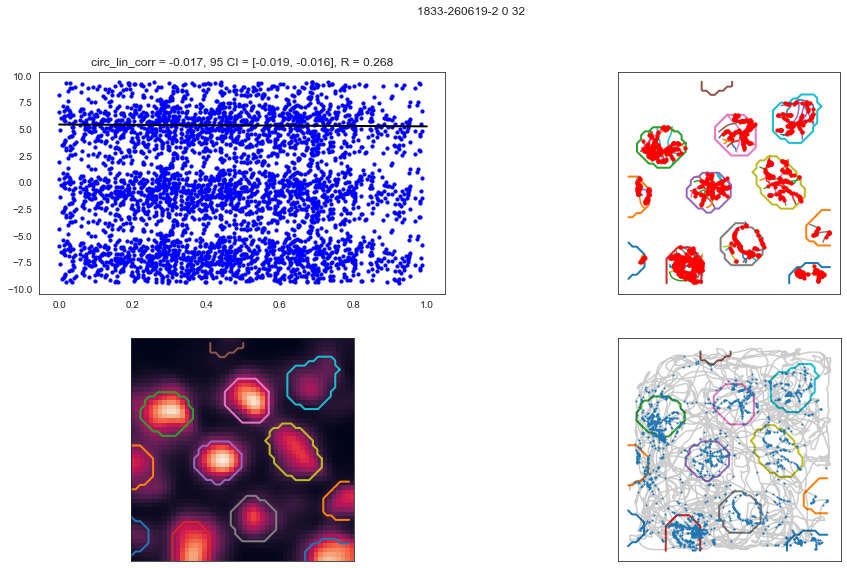

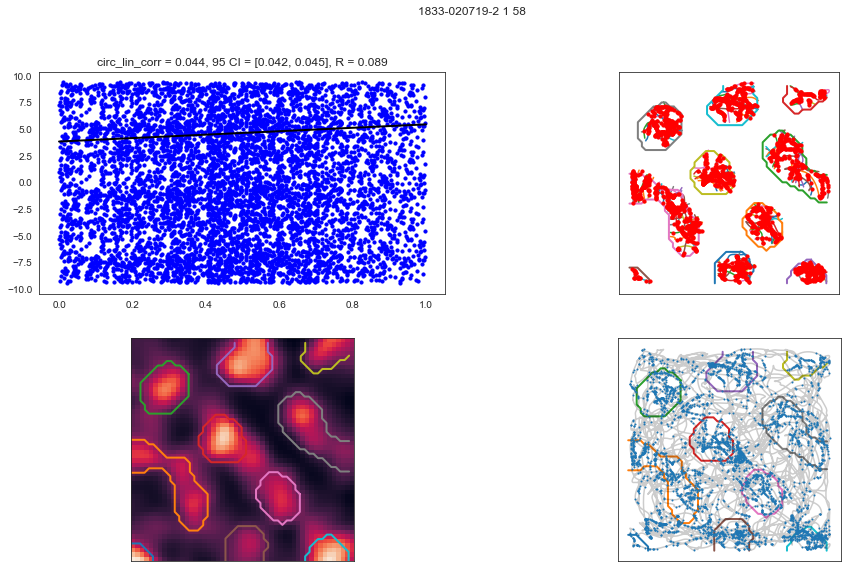

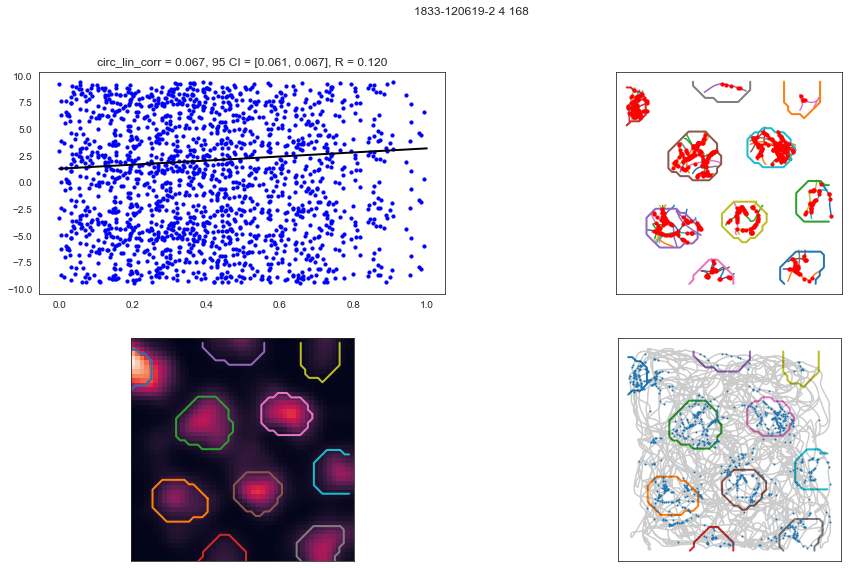

...

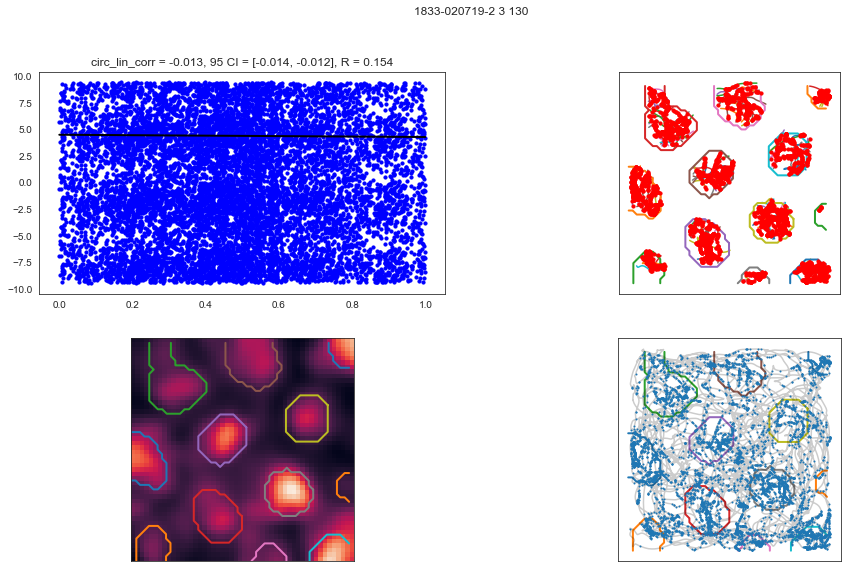

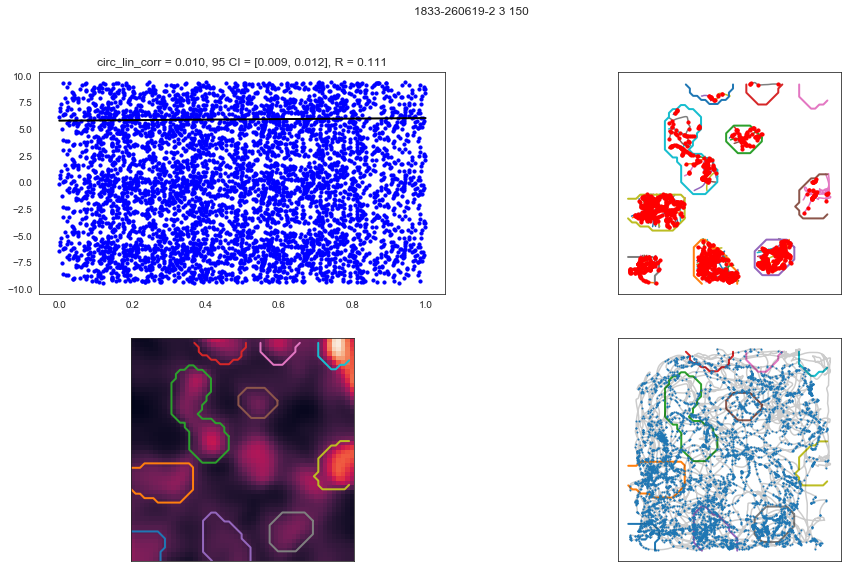

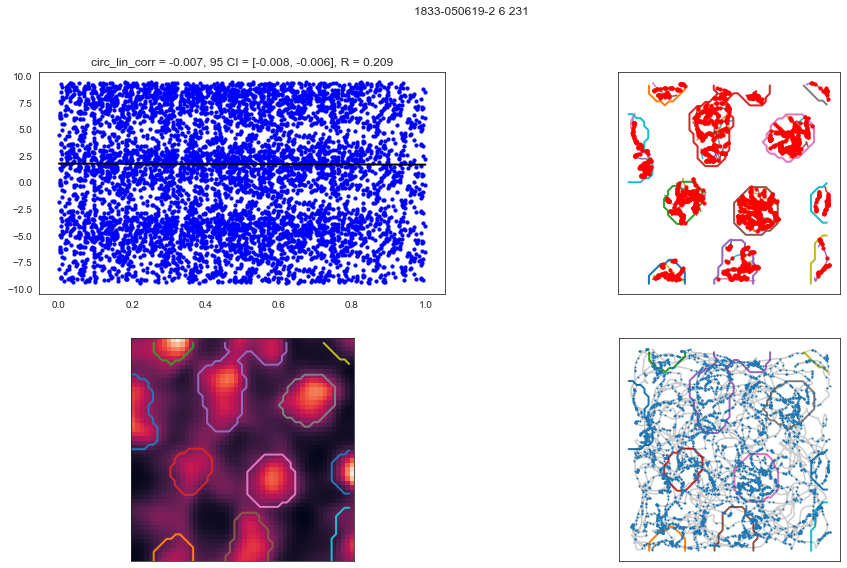

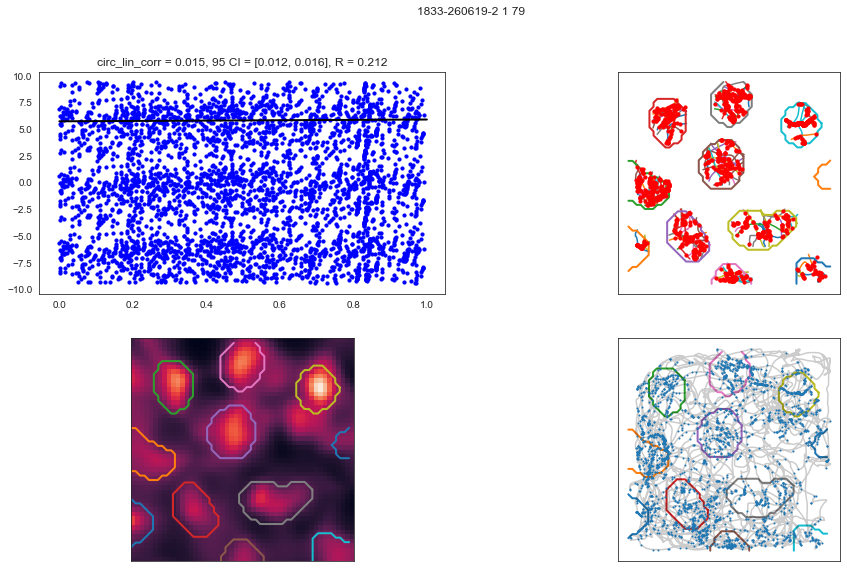

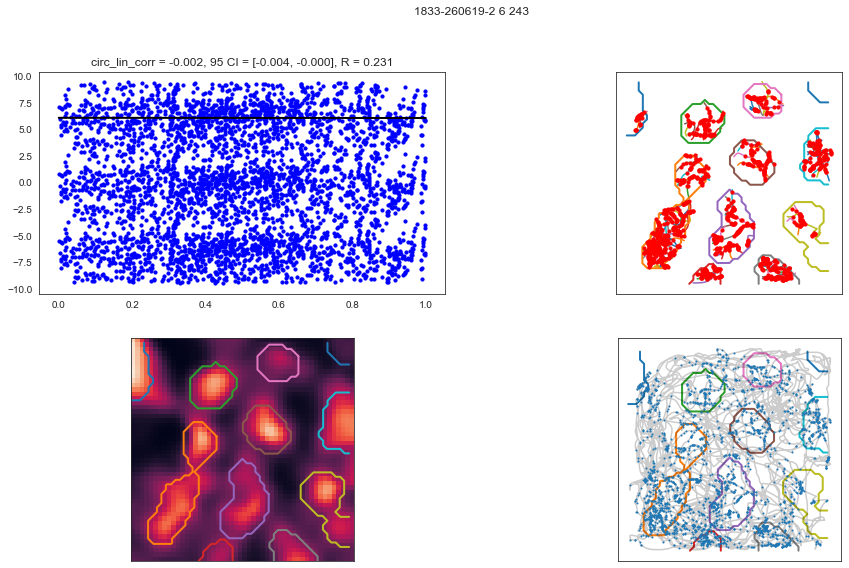

In [197]:
for row in stimulated_11_sub.sort_values('gridness', ascending=False).itertuples():
    compute_phase_precession(row, plot=True, flim=[9,12])

ValueError: The length of x is too small: len(x) < 2.

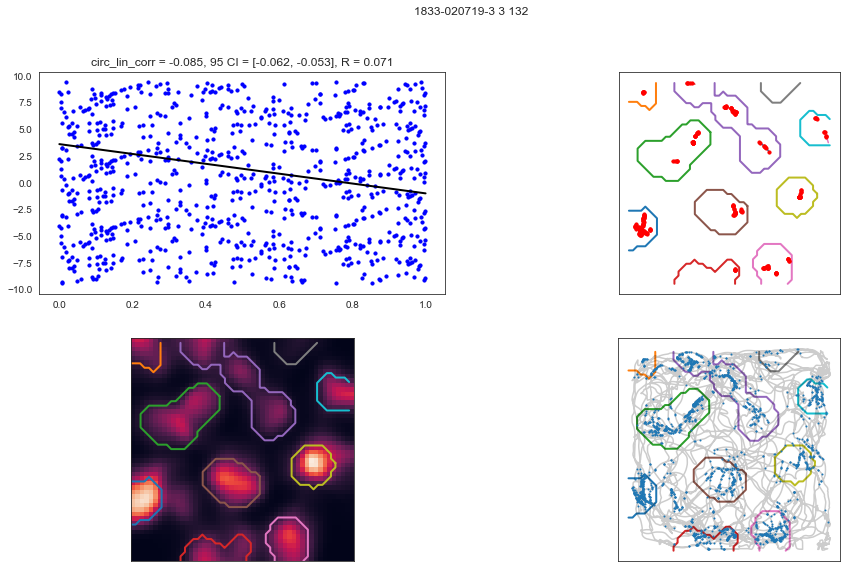

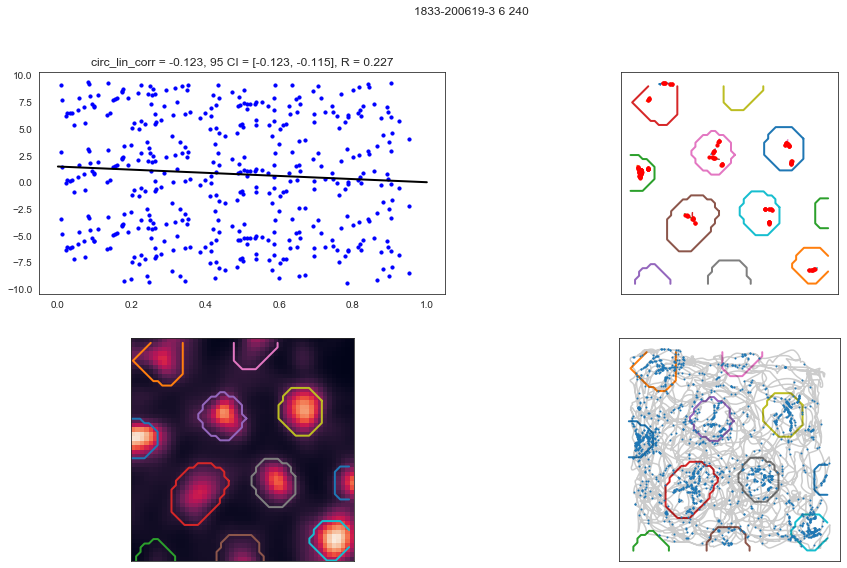

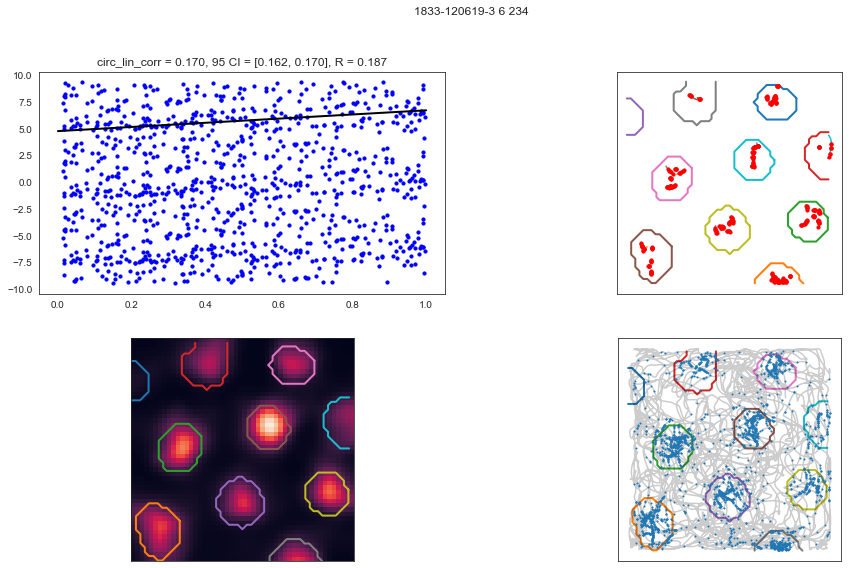

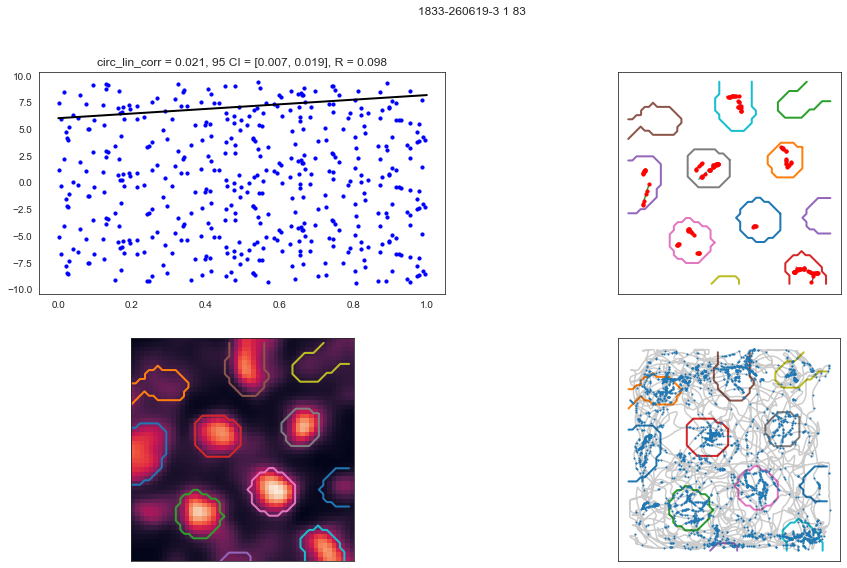

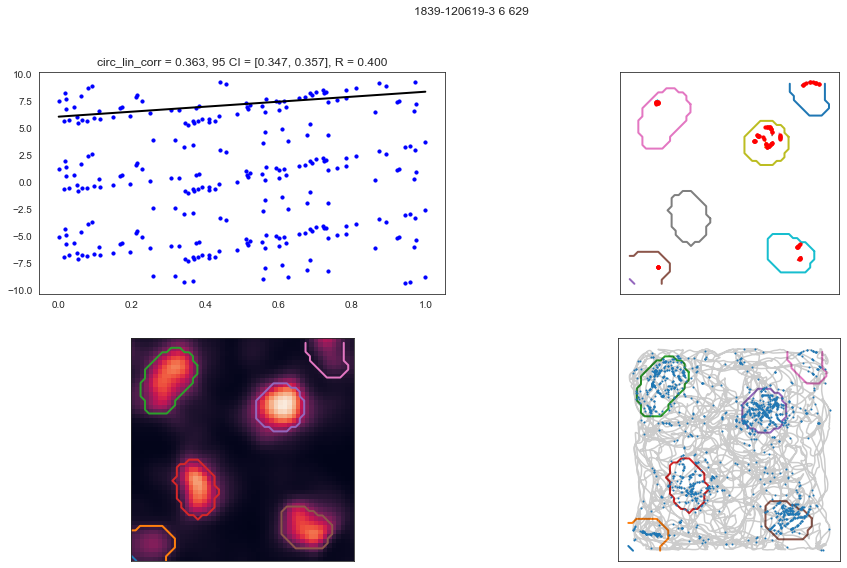

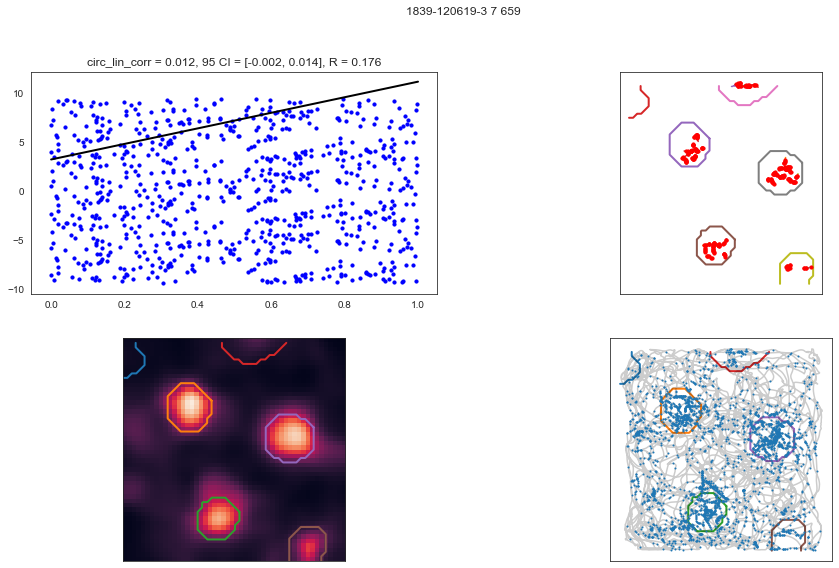

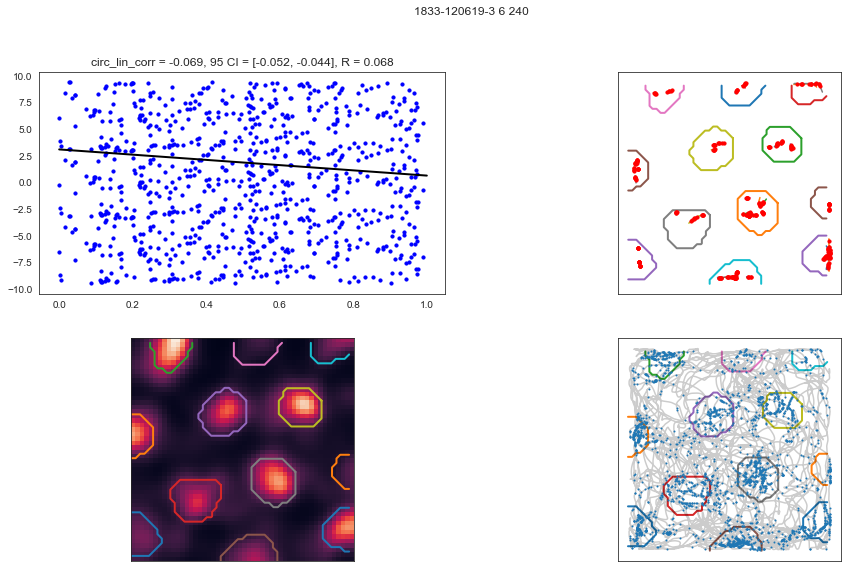

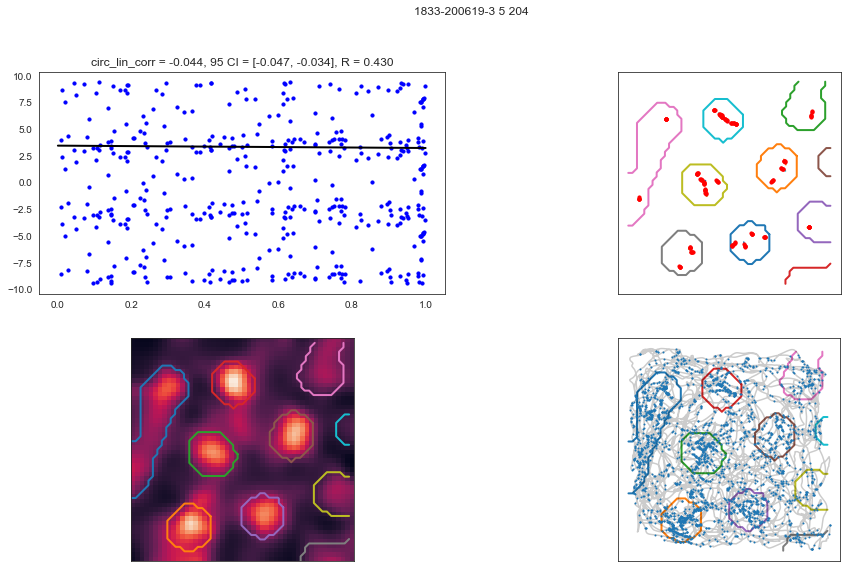

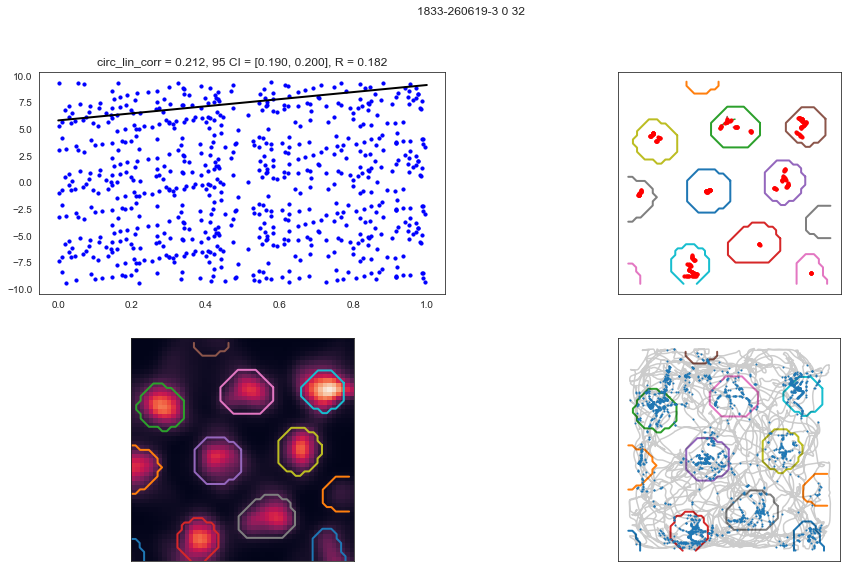

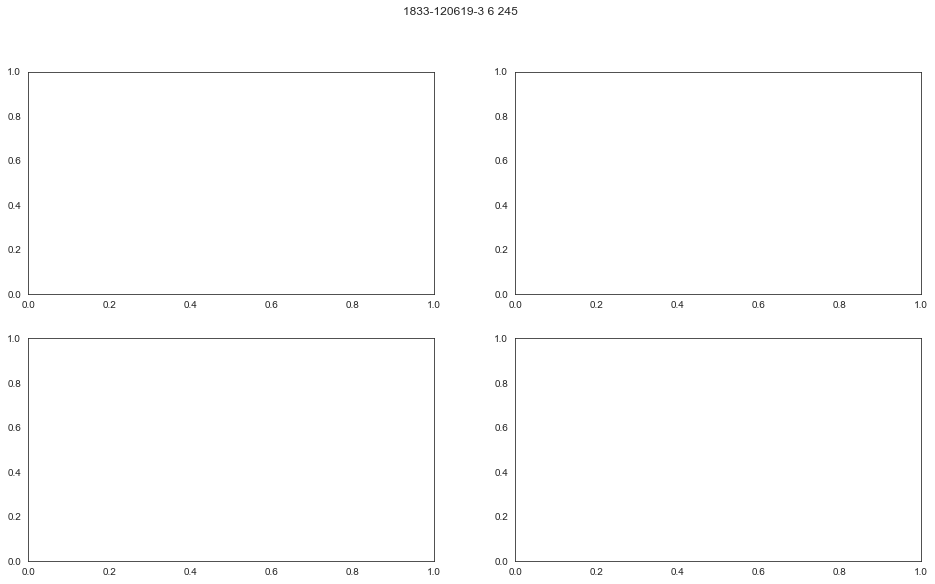

In [198]:
for row in baseline_ii.sort_values('gridness', ascending=False).itertuples():
    compute_phase_precession(row, plot=True)

ValueError: The length of x is too small: len(x) < 2.

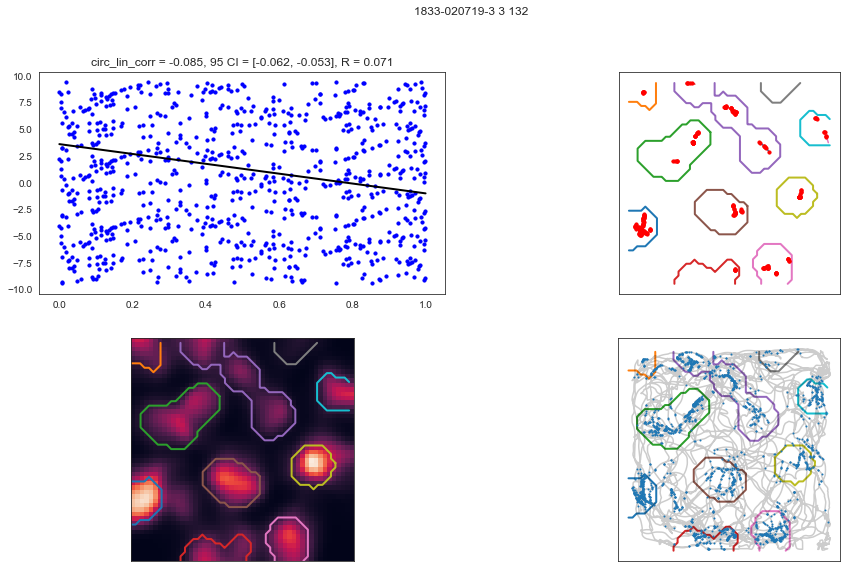

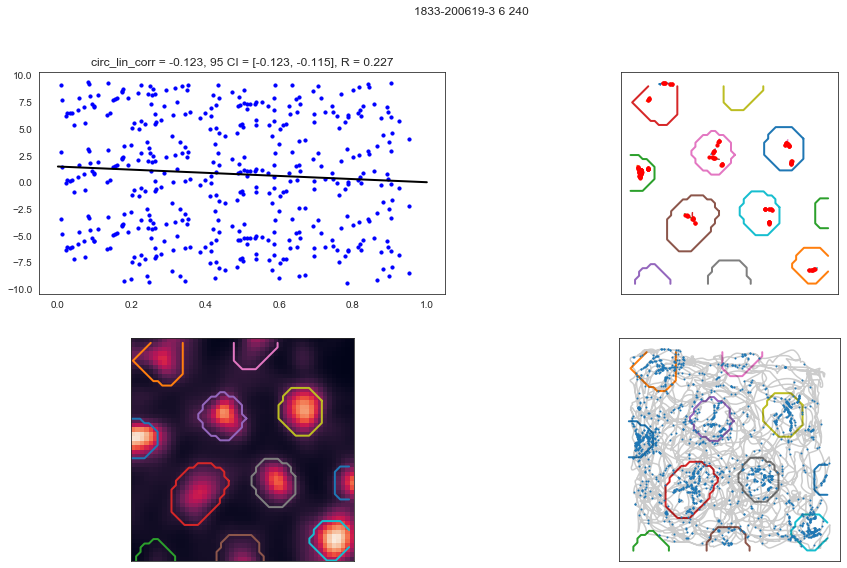

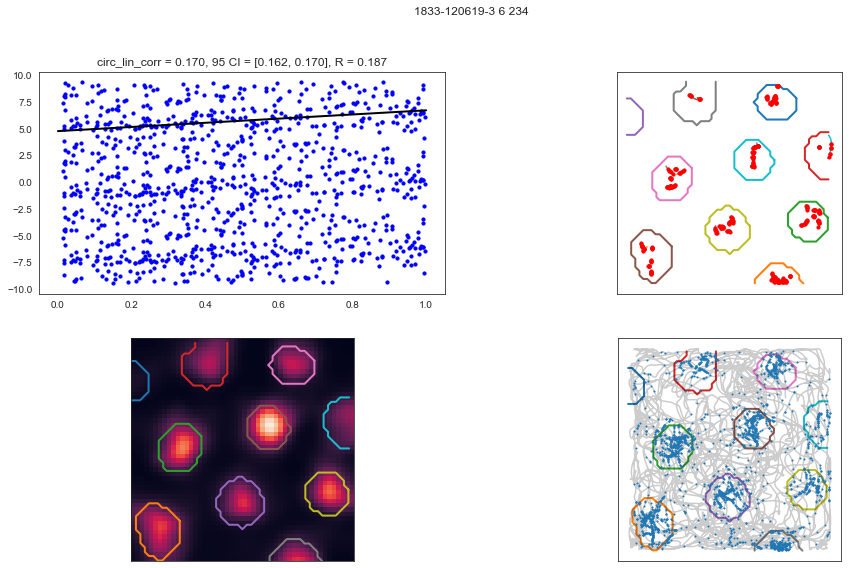

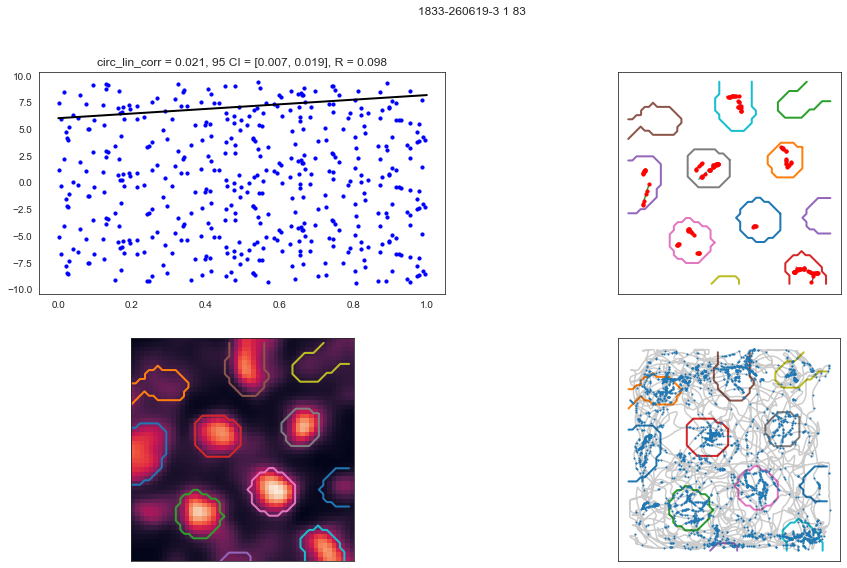

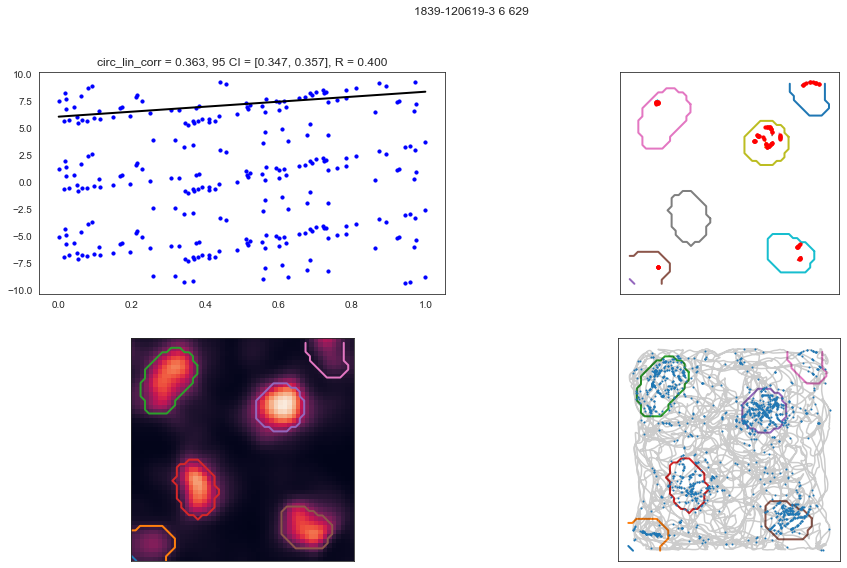

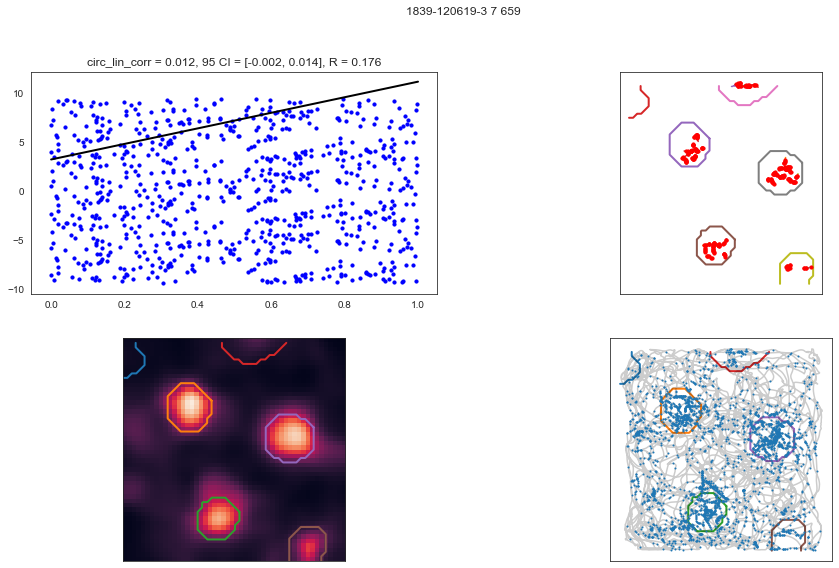

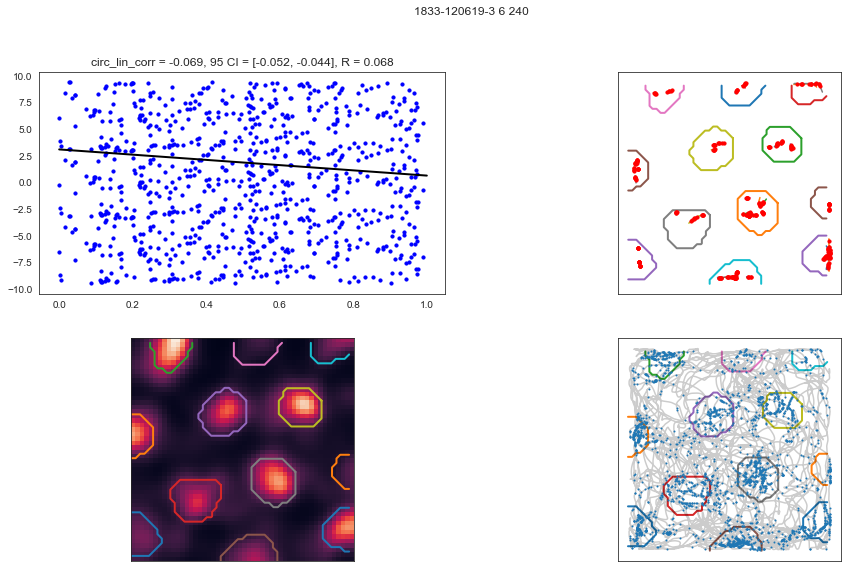

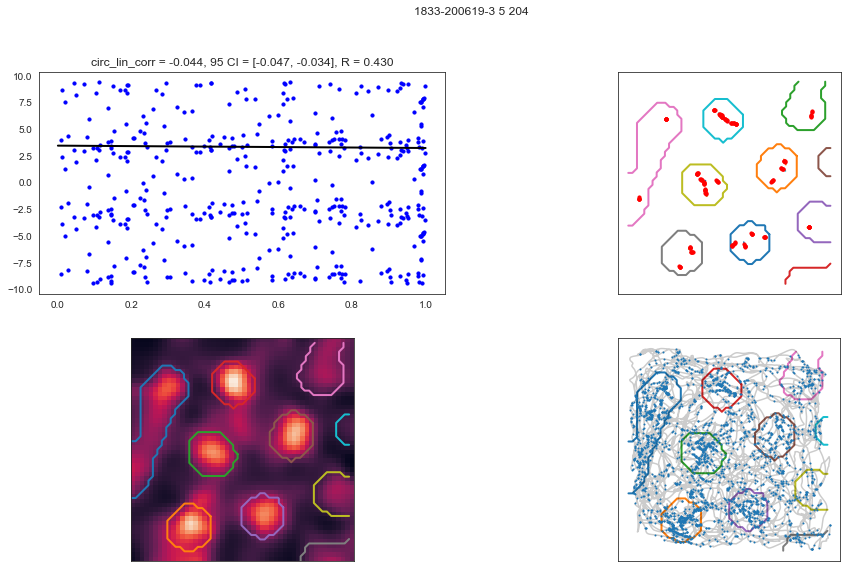

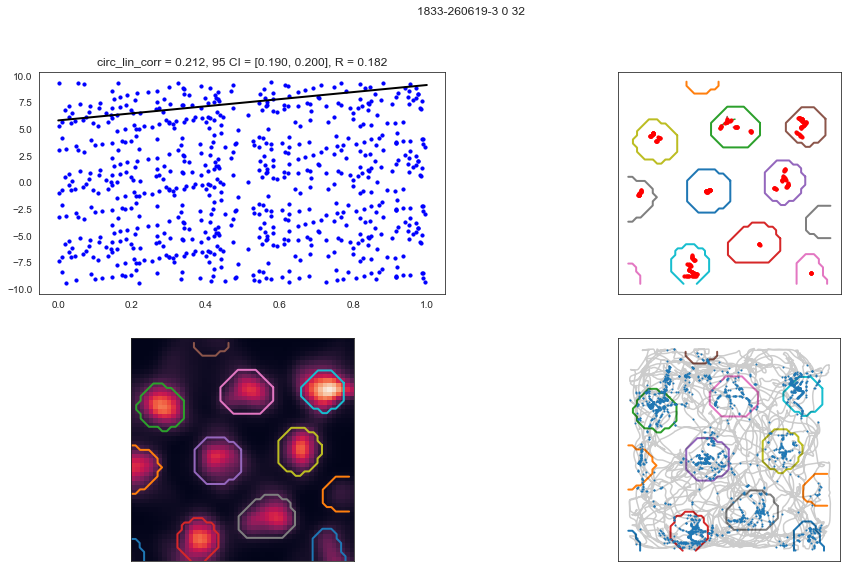

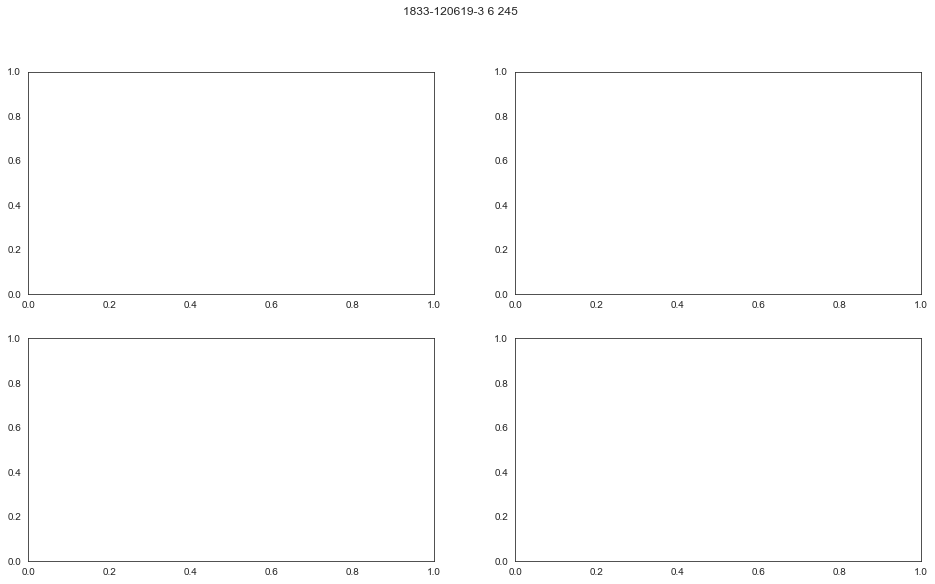

In [198]:
for row in stimulated_30.sort_values('gridness', ascending=False).itertuples():
    compute_phase_precession(row, plot=True)

# Analysis

In [45]:
baseline_i_pp = []
for row in tqdm(baseline_i.itertuples(), total=len(baseline_i)):
    result_cell = compute_phase_precession(row)
    baseline_i_pp.append(result_cell)

stimulated_11_pp = []
for row in tqdm(stimulated_11.itertuples(), total=len(stimulated_11)):
    result_cell = compute_phase_precession(row)
    stimulated_11_pp.append(result_cell)

stimulated_11_stim_pp = []
for row in tqdm(stimulated_11.itertuples(), total=len(stimulated_11)):
    result_cell = compute_phase_precession(row, flim=[9,12])
    stimulated_11_stim_pp.append(result_cell)

baseline_ii_pp = []
for row in tqdm(baseline_ii.itertuples(), total=len(baseline_ii)):
    result_cell = compute_phase_precession(row)
    baseline_ii_pp.append(result_cell)
    
stimulated_30_pp = []
for row in tqdm(stimulated_30.itertuples(), total=len(stimulated_30)):
    result_cell = compute_phase_precession(row, flim=[6,10])
    stimulated_30_pp.append(result_cell)
    
stimulated_stim_30_pp = []
for row in tqdm(stimulated_30.itertuples(), total=len(stimulated_30)):
    result_cell = compute_phase_precession(row, flim=[29,31])
    stimulated_stim_30_pp.append(result_cell)

In [46]:
baseline_i_pp = pd.DataFrame(baseline_i_pp)

stimulated_11_pp = pd.DataFrame(stimulated_11_pp)

stimulated_11_stim_pp = pd.DataFrame(stimulated_11_stim_pp)

baseline_ii_pp = pd.DataFrame(baseline_ii_pp)

stimulated_30_pp = pd.DataFrame(stimulated_30_pp)

stimulated_stim_30_pp = pd.DataFrame(stimulated_stim_30_pp)

In [47]:
stuff = ['action', 'channel_group', 'unit_name', 'unit_idnum', 'unit_id']
baseline_i_pp = baseline_i_pp.merge(data.loc[:,stuff], on=stuff[:3])

stimulated_11_pp = stimulated_11_pp.merge(data.loc[:,stuff], on=stuff[:3])

stimulated_11_stim_pp = stimulated_11_stim_pp.merge(data.loc[:,stuff], on=stuff[:3])

baseline_ii_pp = baseline_ii_pp.merge(data.loc[:,stuff], on=stuff[:3])

stimulated_30_pp = stimulated_30_pp.merge(data.loc[:,stuff], on=stuff[:3])

stimulated_stim_30_pp = stimulated_stim_30_pp.merge(data.loc[:,stuff], on=stuff[:3])

In [48]:
baseline_i_pp['baseline_i'] = True

stimulated_11_pp['stimulated_11'] = True

stimulated_11_stim_pp['stimulated_11_stim'] = True

baseline_ii_pp['baseline_ii'] = True

stimulated_30_pp['stimulated_30'] = True

stimulated_stim_30_pp['stimulated_stim_30'] = True

In [49]:
results = pd.concat([
    baseline_i_pp,
    stimulated_11_pp,
    stimulated_11_stim_pp,
    baseline_ii_pp,
    stimulated_30_pp,
    stimulated_stim_30_pp,
])

/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  import sys


In [50]:
results.reset_index(drop=True).to_feather(output_path / 'results.feather')

In [51]:
def compute_date_idnum(row):
    return '-'.join(row.action.split('-')[:2]) + '_' + str(row.unit_idnum)

In [52]:
baseline_i_pp['date_idnum'] = baseline_i_pp.apply(compute_date_idnum, axis=1)

stimulated_11_pp['date_idnum'] = stimulated_11_pp.apply(compute_date_idnum, axis=1)

stimulated_11_stim_pp['date_idnum'] = stimulated_11_stim_pp.apply(compute_date_idnum, axis=1)

baseline_ii_pp['date_idnum'] = baseline_ii_pp.apply(compute_date_idnum, axis=1)

stimulated_30_pp['date_idnum'] = stimulated_30_pp.apply(compute_date_idnum, axis=1)

stimulated_stim_30_pp['date_idnum'] = stimulated_stim_30_pp.apply(compute_date_idnum, axis=1)

# barplot

In [53]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (2, 2), 
    'figure.dpi': 150
})

In [54]:
query = 'pval_dist < 0.01 and RR_dist > .1'

In [55]:
precess_i = sum(baseline_i_pp.query(query).circ_lin_corr_dist < 0) / len(baseline_i_pp) * 100
recess_i = sum(baseline_i_pp.query(query).circ_lin_corr_dist > 0) / len(baseline_i_pp) * 100
stim_11 = len(stimulated_11_pp.query(query).circ_lin_corr_dist)
precess_ii = sum(baseline_ii_pp.query(query).circ_lin_corr_dist < 0) / len(baseline_ii_pp) * 100
recess_ii = sum(baseline_ii_pp.query(query).circ_lin_corr_dist > 0) / len(baseline_ii_pp) * 100
stim_30 = len(stimulated_30_pp.query(query).circ_lin_corr_dist)

In [57]:
precess_i_N = sum(baseline_i_pp.query(query).circ_lin_corr_dist < 0), len(baseline_i_pp)
recess_i_N = sum(baseline_i_pp.query(query).circ_lin_corr_dist > 0), len(baseline_i_pp) 
stim_11_N = len(stimulated_11_pp.query(query).circ_lin_corr_dist)
precess_ii_N = sum(baseline_ii_pp.query(query).circ_lin_corr_dist < 0), len(baseline_ii_pp)
recess_ii_N = sum(baseline_ii_pp.query(query).circ_lin_corr_dist > 0), len(baseline_ii_pp)
stim_30_N = len(stimulated_30_pp.query(query).circ_lin_corr_dist)

In [58]:
print(precess_i_N)
print(recess_i_N)
print(stim_11_N)
print(precess_ii_N) 
print(recess_ii_N)
print(stim_30_N)

(6, 66)
(9, 66)
0
(10, 56)
(3, 56)
0


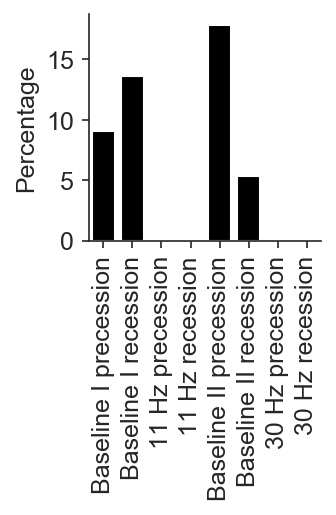

In [56]:
fig = plt.figure()
sns.barplot(data=[
    [precess_i], 
    [recess_i], 
    [stim_11],
    [stim_11],
    [precess_ii], 
    [recess_ii], 
    [stim_30],
    [stim_30]
], color='k')
plt.xticks(
    range(8),
    [
        'Baseline I precession', 
        'Baseline I recession', 
        '11 Hz precession',
        '11 Hz recession',
        'Baseline II precession', 
        'Baseline II recession', 
        '30 Hz precession',
        '30 Hz recession'
    ], rotation=90)
plt.ylabel('Percentage')
despine()
figname = f'phase-precession-quantification'
fig.savefig(
    output_path / 'figures' / f'{figname}.png', 
    bbox_inches='tight', transparent=True)
fig.savefig(
    output_path / 'figures' / f'{figname}.svg', 
    bbox_inches='tight', transparent=True)

# hist

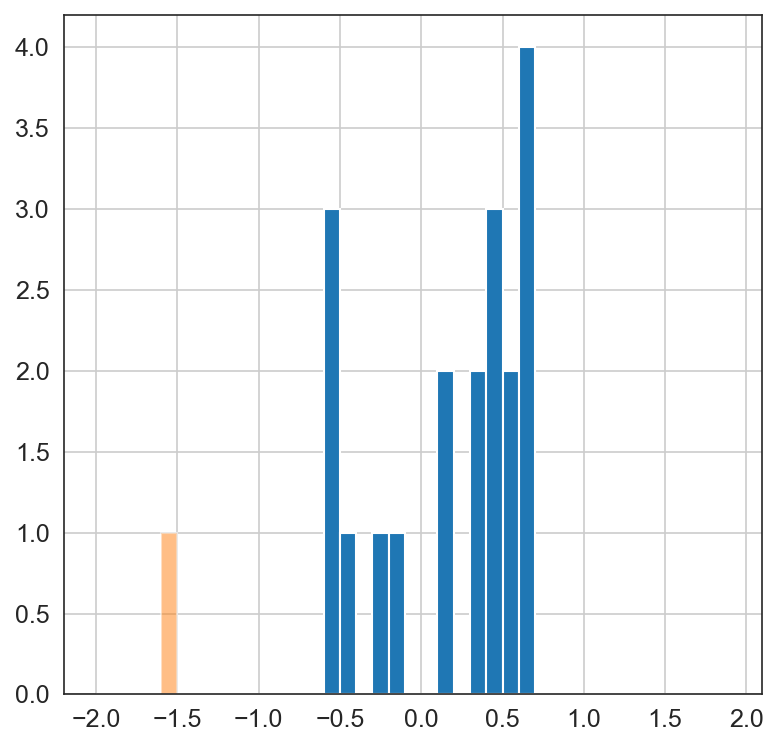

In [448]:
bins = np.arange(-2, 2, .1)

baseline_i_pp.query('pval_dist < 0.01').slope_dist.hist(density=False, bins=bins)
stimulated_11_pp.query('pval_dist < 0.01').slope_dist.hist(
        density=False, bins=bins, alpha=.5)

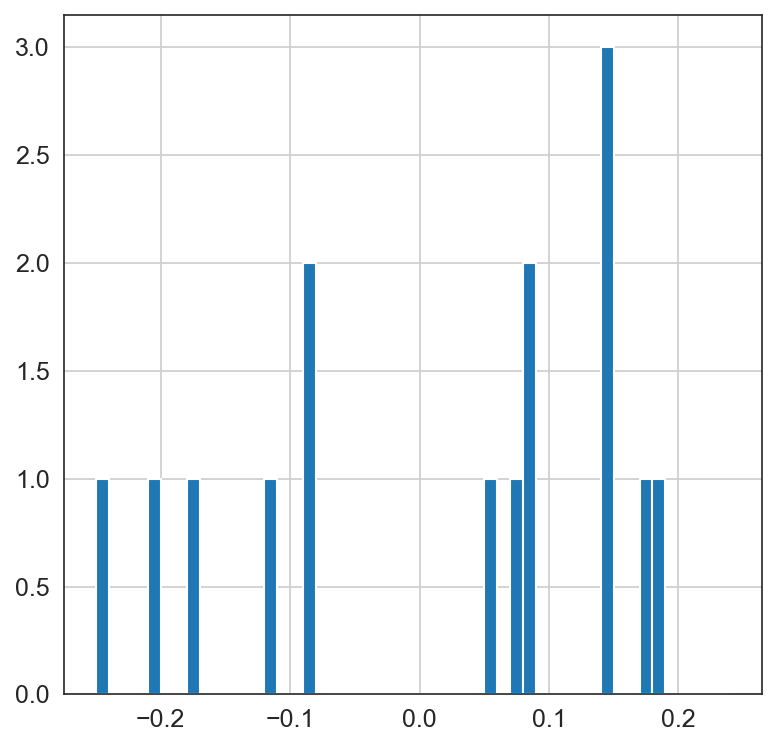

In [447]:
bins = np.arange(-.25, .25, .01)
density=False
baseline_i_pp.query('pval_dist < 0.01 and RR_dist > .1').circ_lin_corr_dist.hist(
    density=density, bins=bins)
stimulated_11_pp.query('pval_dist < 0.01 and RR_dist > .1').circ_lin_corr_dist.hist(
    density=density, bins=bins, alpha=.5)

In [408]:
baseline_i_pp['slope_R_dist'] = baseline_i_pp.slope_dist * baseline_i_pp.RR_dist
stimulated_11_pp['slope_R_dist'] = stimulated_11_pp.slope_dist * stimulated_11_pp.RR_dist

In [409]:
baseline_i_pp['r_R_dist'] = baseline_i_pp.circ_lin_corr_dist * baseline_i_pp.RR_dist
stimulated_11_pp['r_R_dist'] = stimulated_11_pp.circ_lin_corr_dist * stimulated_11_pp.RR_dist

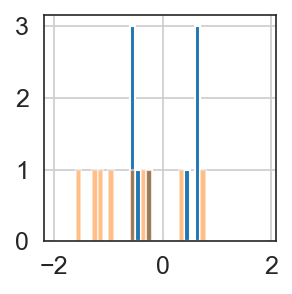

In [410]:
bins = np.arange(-2, 2, .1)
baseline_i_pp_sig = baseline_i_pp.query('pval_dist < 0.05')
baseline_i_pp_sig_date_idnum = baseline_i_pp_sig.date_idnum.unique()
stimulated_11_pp_sig = stimulated_11_pp.query('date_idnum in @baseline_i_pp_sig_date_idnum')
stimulated_11_pp_sig_date_idnum = stimulated_11_pp_sig.date_idnum.unique()
baseline_i_pp_sig = baseline_i_pp_sig.query('date_idnum in @stimulated_11_pp_sig_date_idnum')

baseline_i_pp_sig.slope_dist.hist(density=False, bins=bins)
stimulated_11_pp_sig.slope_dist.hist(density=False, bins=bins, alpha=.5)

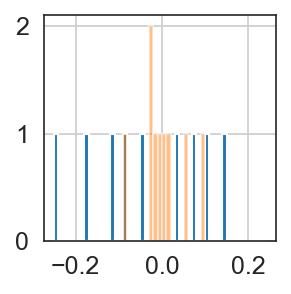

In [411]:
bins = np.arange(-.25, .25, .01)
baseline_i_pp_sig.circ_lin_corr_dist.hist(density=False, bins=bins)
stimulated_11_pp_sig.circ_lin_corr_dist.hist(density=False, bins=bins, alpha=.5)

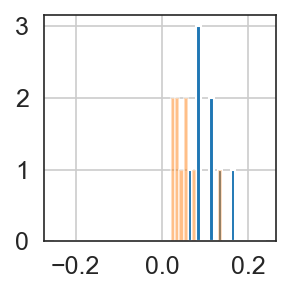

In [412]:
baseline_i_pp_sig.RR_dist.hist(density=False, bins=bins)
stimulated_11_pp_sig.RR_dist.hist(density=False, bins=bins, alpha=.5)

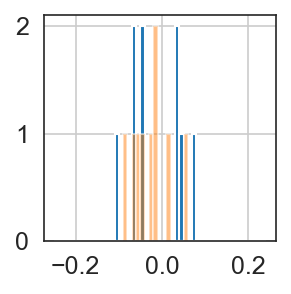

In [413]:
baseline_i_pp_sig.slope_R_dist.hist(density=False, bins=bins)
stimulated_11_pp_sig.slope_R_dist.hist(density=False, bins=bins, alpha=.5)

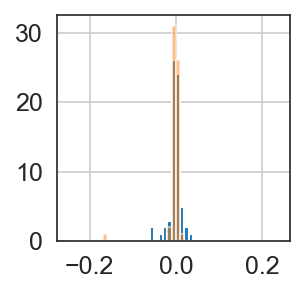

In [414]:
bins = np.arange(-.25, .25, .01)
baseline_i_pp.r_R_dist.hist(density=False, bins=bins)
stimulated_11_pp.r_R_dist.hist(density=False, bins=bins, alpha=.5)

In [415]:
baseline_i_pp_stimulated_11_pp = baseline_i_pp.merge(stimulated_11_pp, on='date_idnum')

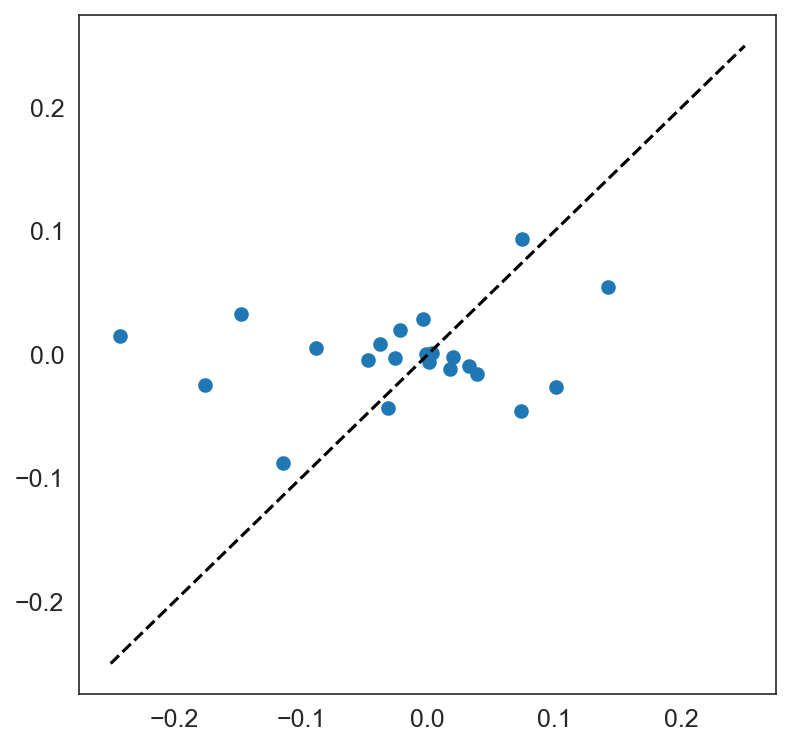

In [452]:
plt.scatter(
    baseline_i_pp_stimulated_11_pp.circ_lin_corr_dist_x, 
    baseline_i_pp_stimulated_11_pp.circ_lin_corr_dist_y,
)
plt.plot([-.25, 0.25], [-.25, 0.25], '--k')

In [446]:
baseline_i_pp_stimulated_11_pp.query('pval_dist_y < 0.01').loc[:, [
    'RR_dist_x', 'circ_lin_corr_dist_x', 
    'RR_dist_y', 'circ_lin_corr_dist_y', 
    'action_y', 'unit_idnum_y']]

,RR_dist_x,circ_lin_corr_dist_x,RR_dist_y,circ_lin_corr_dist_y,action_y,unit_idnum_y
13,0.083627,0.074713,0.050477,0.093518,1833-120619-2,233


In [445]:
stimulated_11_pp.query('pval_dist < 0.01 and RR_dist > 0.1').loc[:, [
    'RR_dist', 'circ_lin_corr_dist', 'pval_dist',
    'action', 'unit_idnum'
]]

,RR_dist,circ_lin_corr_dist,pval_dist,action,unit_idnum


In [427]:
plt.rc('axes', titlesize=12)
plt.rcParams.update({
    'font.size': 12, 
    'figure.figsize': (6, 6), 
    'figure.dpi': 150
})

{'action': '1839-120619-2',
 'channel_group': 6,
 'unit_name': 106,
 'circ_lin_corr_dist': -0.11445218085660203,
 'pval_dist': 0.03558411784503357,
 'slope_dist': -0.8698732948412091,
 'phi0_dist': 3.89838512340452,
 'RR_dist': 0.15160195974199475,
 'circ_lin_corr_dur': -0.1699451973400952,
 'pval_dur': 0.0012656020106374122,
 'slope_dur': -0.8051851328081773,
 'phi0_dur': 3.7556339993235173,
 'RR_dur': 0.16494067381412736}

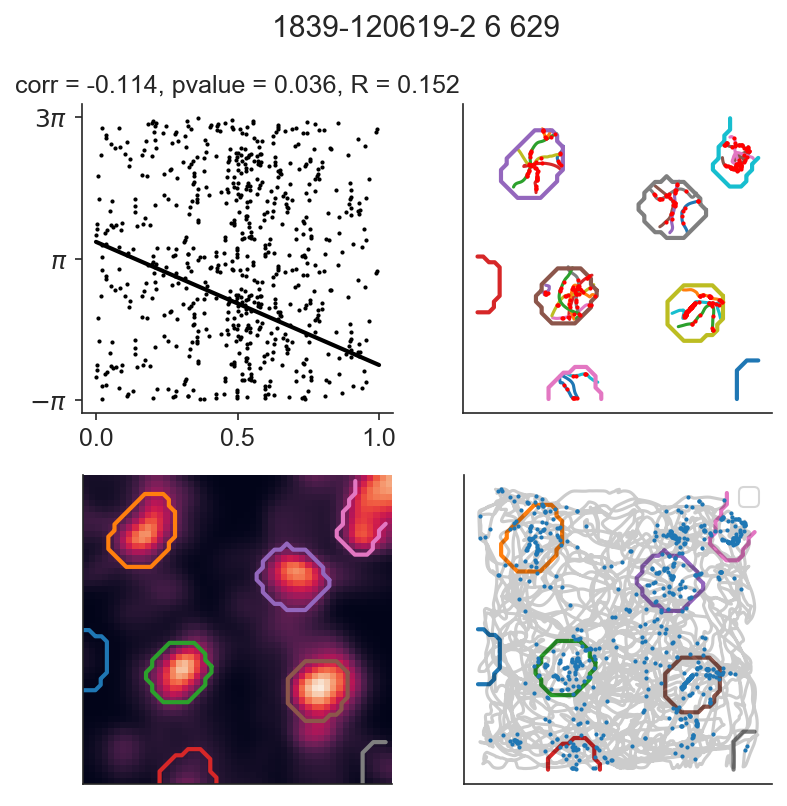

In [444]:
compute_phase_precession(
#     stimulated_11.query('action=="1834-220319-2" and unit_idnum==358').iloc[0],
    stimulated_11.query('action=="1839-120619-2" and unit_idnum==629').iloc[0],
    plot=True, plot_grid=True, flim=[6,10]
)

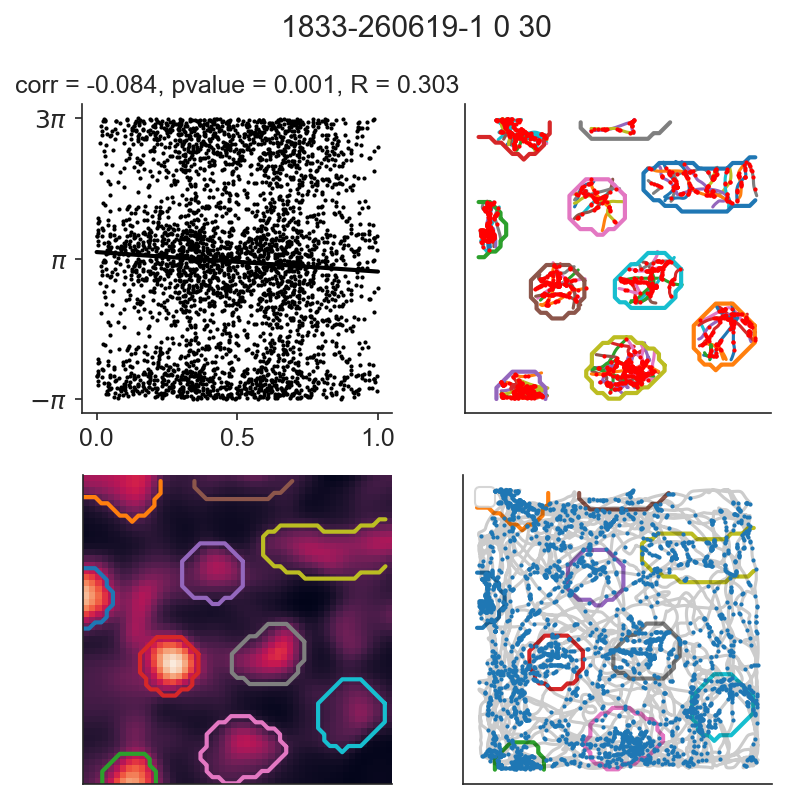

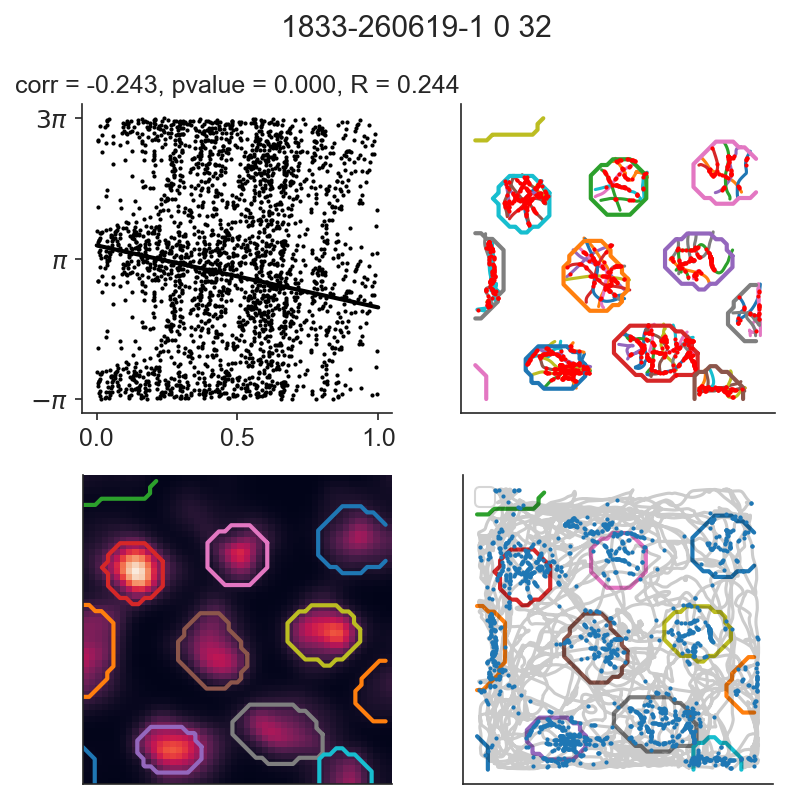

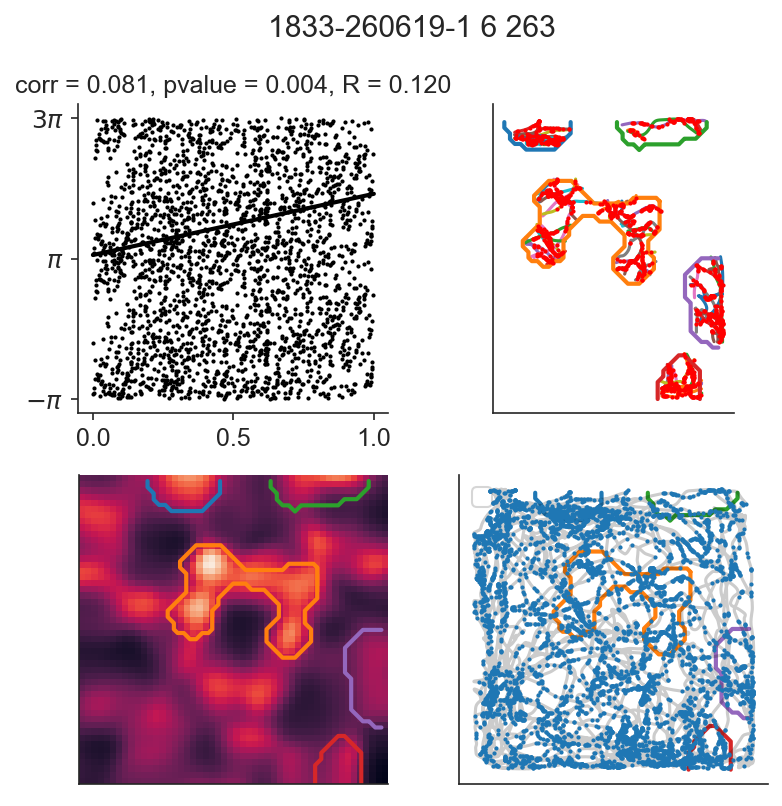

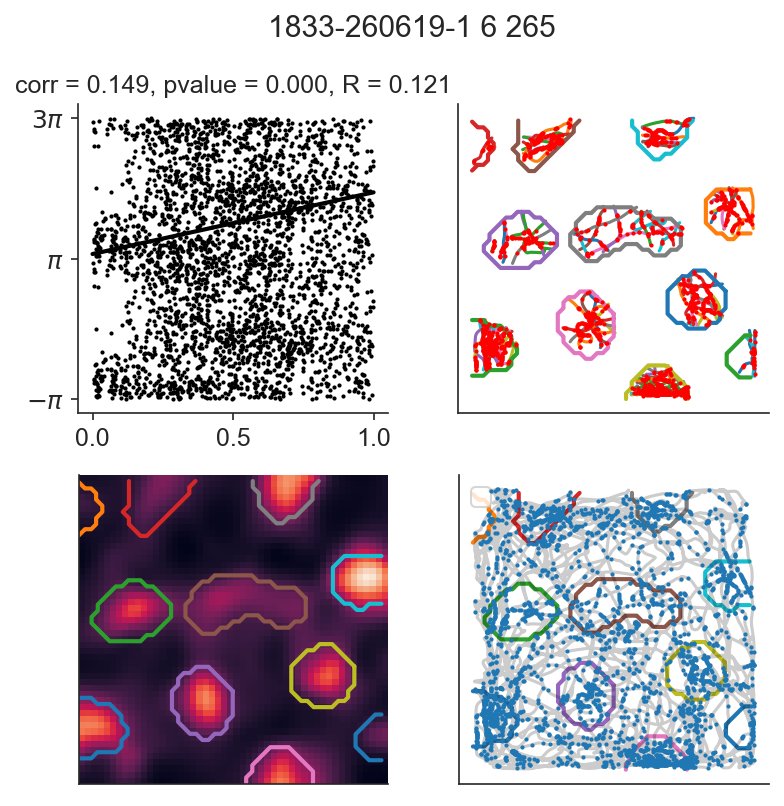

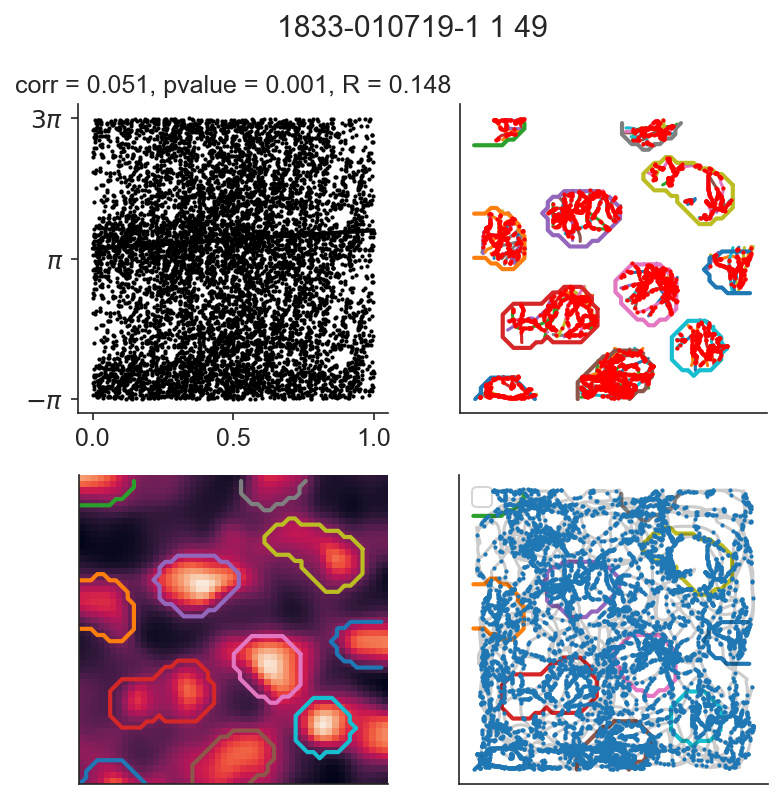

...

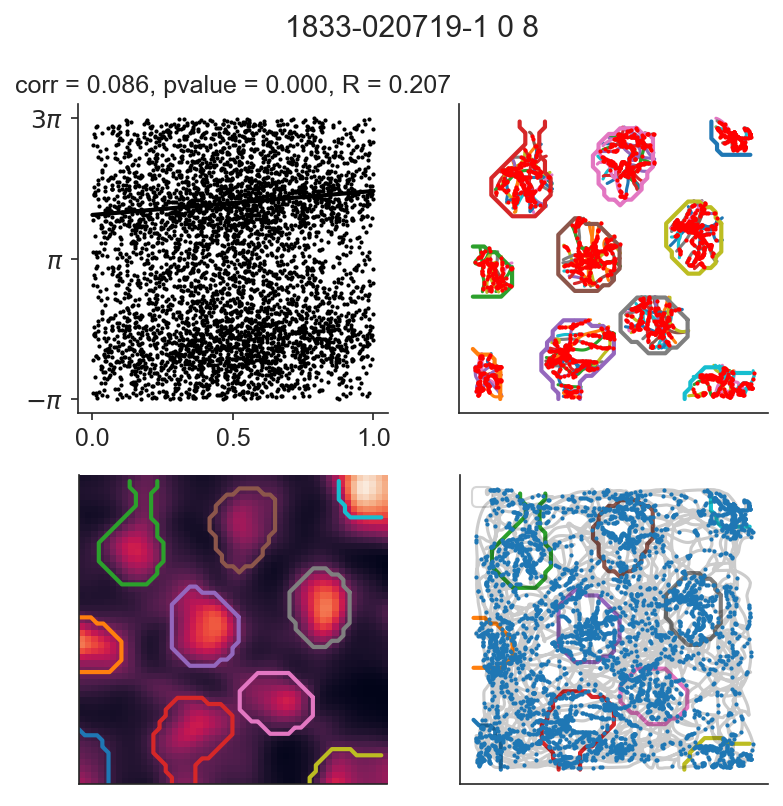

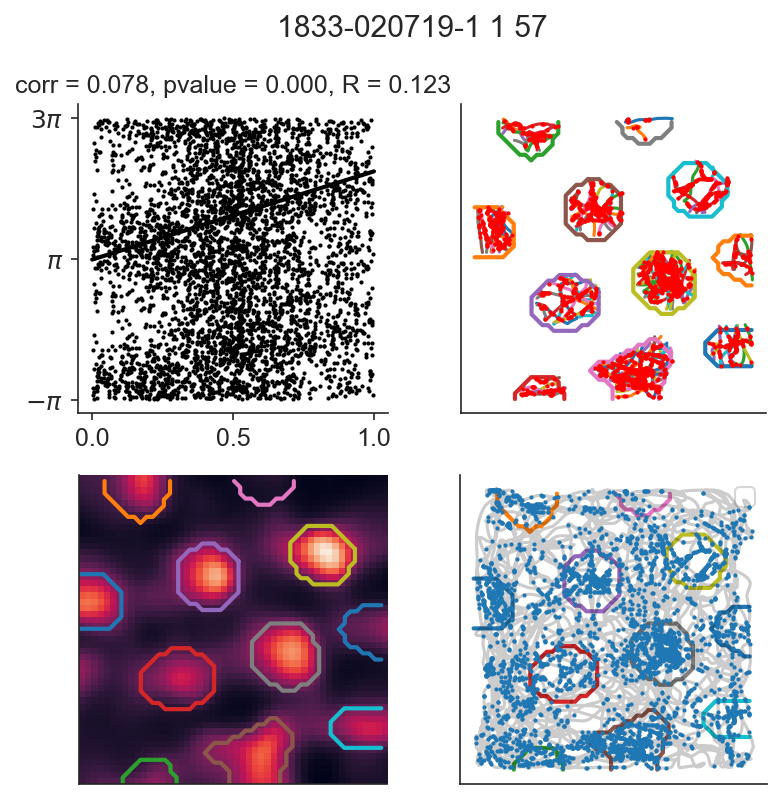

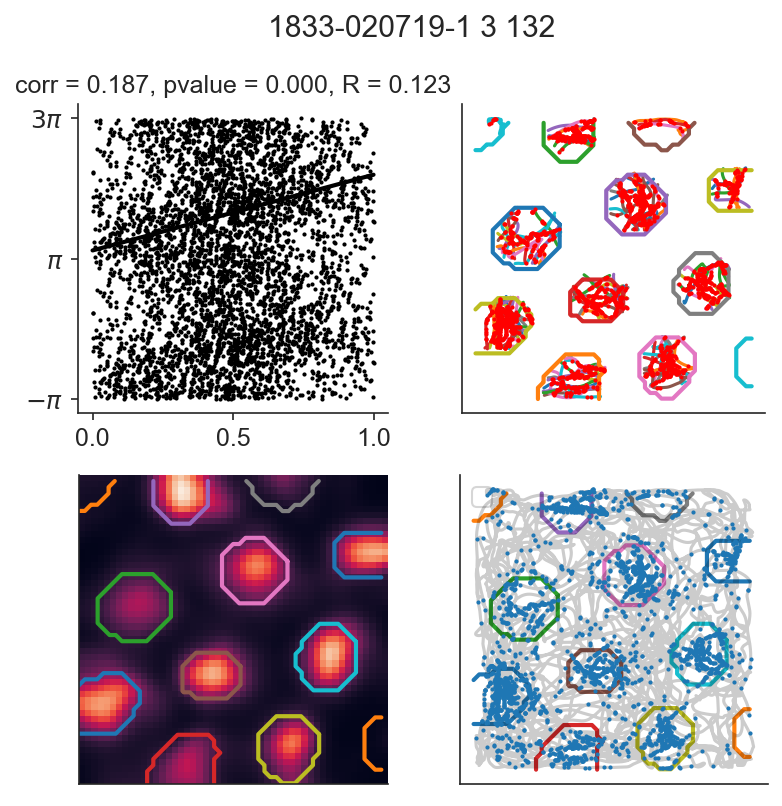

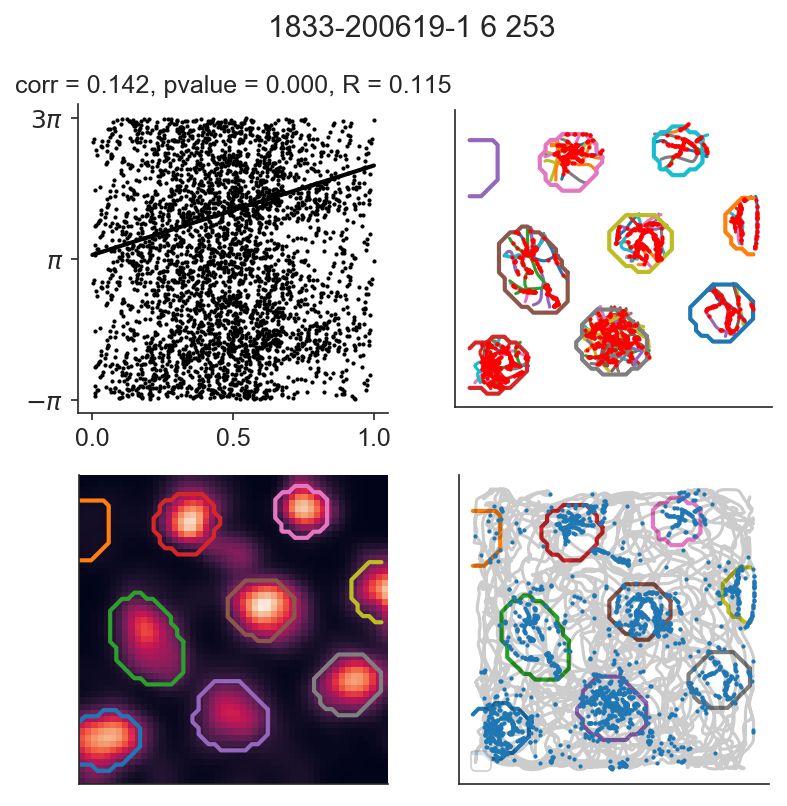

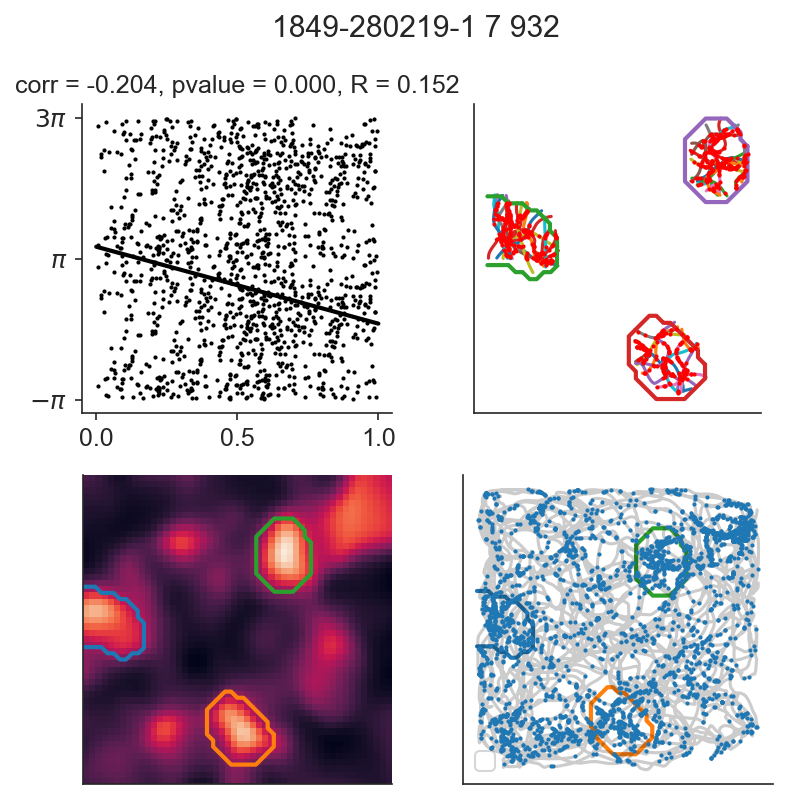

In [450]:
for row in baseline_i_pp.query('pval_dist < 0.01 and RR_dist > .1').itertuples():
    compute_phase_precession(
        row, plot=True, plot_grid=True, flim=[6,10]
    )

# Save to expipe

In [480]:
action = project.require_action("phase-precession")

[autoreload of scipy.stats.stats failed: Traceback (most recent call last):
  File "/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 244, in check
    superreload(m, reload, self.old_objects)
  File "/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/IPython/extensions/autoreload.py", line 378, in superreload
    module = reload(module)
  File "/home/mikkel/.virtualenvs/expipe/lib/python3.6/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/home/mikkel/.virtualenvs/expipe/lib/python3.6/importlib/__init__.py", line 166, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 618, in _exec
  File "<frozen importlib._bootstrap_external>", line 678, in exec_module
  File "<frozen importlib._bootstrap>", line 219, in _call_with_frames_removed
  File "/home/mikkel/.virtualenvs/expipe/lib/python3.6/site-packages/scipy/stats/stats.py", line 180, in <module>
    import scipy.sp

In [481]:
copy_tree(output_path, str(action.data_path()))

['/media/storage/expipe/septum-mec/actions/phase-precession/data/results.feather',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-120619-2 4 168.svg',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-260619-2_0_32_f10-12.png',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-260619-2_0_32_f6-10.png',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/phase-precession-quantification.svg',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-010719-1 3 121.svg',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-120619-2_4_168_f10-12.png',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-010719-2 3 121.png',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-120619-2_4_168_f10-12.svg',
 '/media/storage/expipe/septum-mec/actions/phase-precession/data/figures/1833-010719-1 3

In [482]:
septum_mec.analysis.registration.store_notebook(action, "20_phase-precession.ipynb")

# The inverted grid

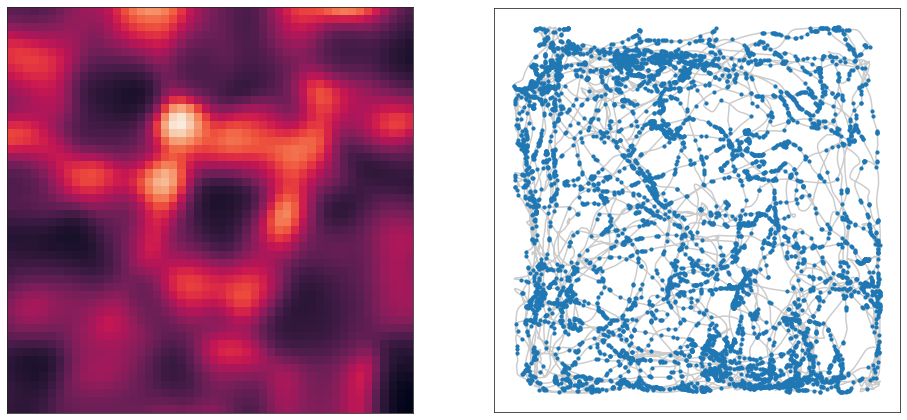

In [31]:
fig, axs = plt.subplots(1, 2, figsize=(16,9))
row = baseline_i.sort_values('gridness', ascending=False).iloc[9]
lfp = data_loader.lfp(row.action, row.channel_group)
spikes = data_loader.spike_train(row.action, row.channel_group, row.unit_name)
rate_map = data_loader.rate_map(row.action, row.channel_group, row.unit_name, smoothing=0.04)
pos_x, pos_y, pos_t, pos_speed = map(data_loader.tracking(row.action).get, ['x', 'y', 't', 'v'])
spikes = np.array(spikes)
spikes = spikes[(spikes > pos_t.min()) & (spikes < pos_t.max())]

axs[0].imshow(rate_map.T, extent=[0, box_size[0], 0, box_size[1]], origin='lower')
axs[1].plot(pos_x, pos_y, color='k', alpha=.2, zorder=1000)
axs[1].scatter(interp1d(pos_t, pos_x)(spikes), interp1d(pos_t, pos_y)(spikes), s=10, zorder=10001)

for ax in axs:
    ax.axis('image')
    ax.set_xticks([])
    ax.set_yticks([])
